In [1]:
from google.colab import drive

drive.mount('/content/drive')


Mounted at /content/drive


In [2]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
import numpy as np


In [3]:
path_2x2 = "/content/drive/MyDrive/dataset/puzzle_2x2/*.jpg"
path_4x4 = "/content/drive/MyDrive/dataset/puzzle_4x4/*.jpg"
path_8x8 = "/content/drive/MyDrive/dataset/puzzle_8x8/*.jpg"

images_2x2 = sorted(glob.glob(path_2x2))
images_4x4 = sorted(glob.glob(path_4x4))
images_8x8 = sorted(glob.glob(path_8x8))

print("2x2 files:", len(images_2x2))
print("4x4 files:", len(images_4x4))
print("8x8 files:", len(images_8x8))


2x2 files: 110
4x4 files: 110
8x8 files: 110


# 1) Gray Scaling Images


In [4]:
grayscale_images = []

for img_path in images_8x8:
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    grayscale_images.append(gray)

print(f"Total images processed: {len(grayscale_images)}")


Total images processed: 110


In [5]:
for img_path in images_2x2[:3]:
    img = cv2.imread(img_path)
    print("Loaded:", img_path, "| Shape:", img.shape)


Loaded: /content/drive/MyDrive/dataset/puzzle_2x2/0.jpg | Shape: (224, 224, 3)
Loaded: /content/drive/MyDrive/dataset/puzzle_2x2/1.jpg | Shape: (224, 224, 3)
Loaded: /content/drive/MyDrive/dataset/puzzle_2x2/10.jpg | Shape: (224, 224, 3)


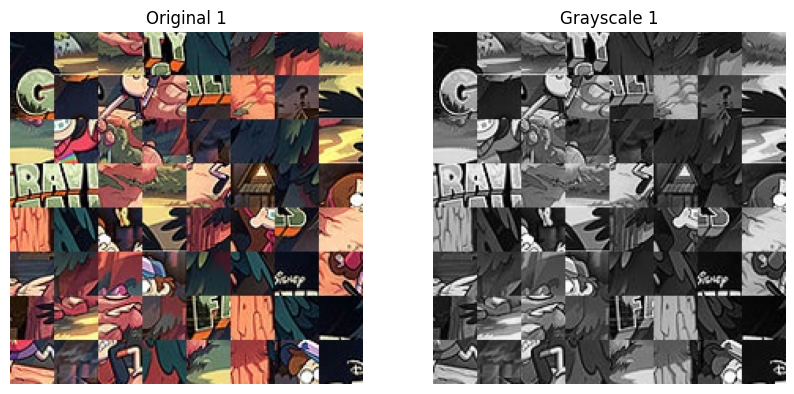

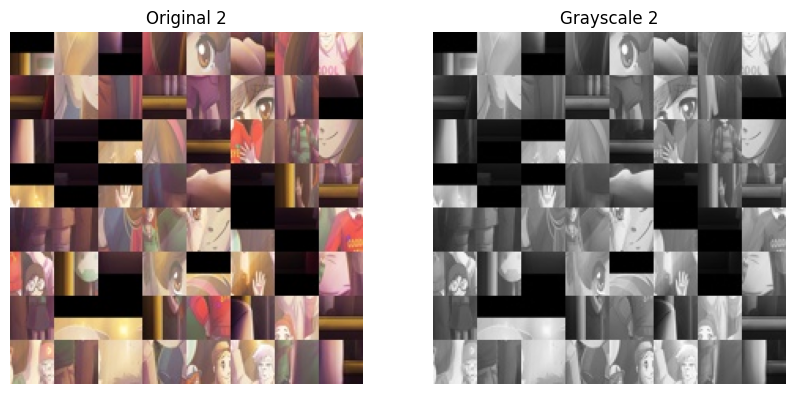

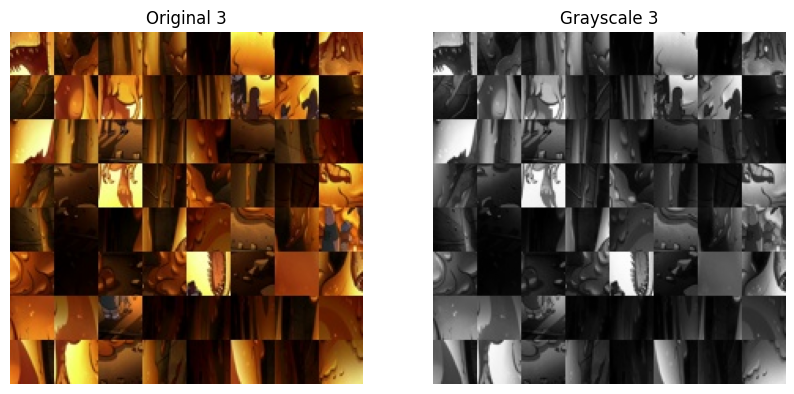

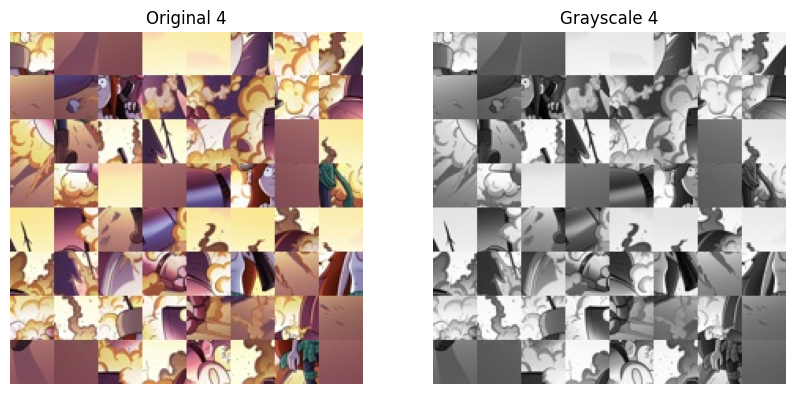

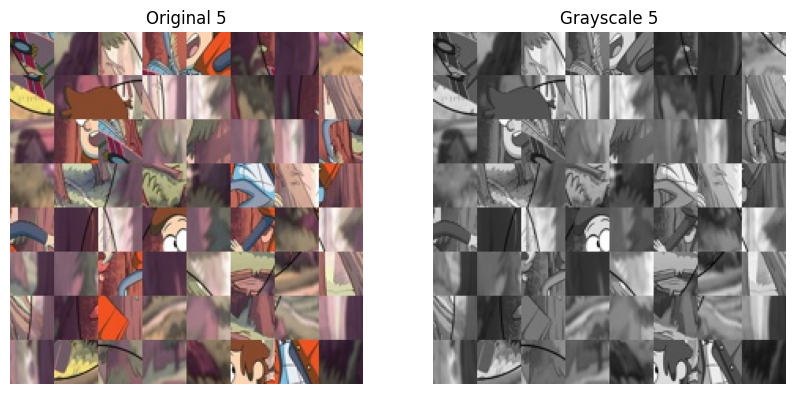

In [6]:
for i in range(5):
    img = cv2.imread(images_8x8[i])
    gray = grayscale_images[i]

    plt.figure(figsize=(10,5))

    plt.subplot(1,2,1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(f"Original {i+1}")
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.imshow(gray, cmap="gray")
    plt.title(f"Grayscale {i+1}")
    plt.axis("off")

    plt.show()


# Noise Reduction

In [ ]:
gaussian_images = []

kernel_size = (5,5)

for gray in grayscale_images:
    blur = cv2.GaussianBlur(gray, kernel_size, 0)
    gaussian_images.append(blur)

print(f"Total images after Gaussian blur: {len(gaussian_images)}")


Total images after Gaussian blur: 110


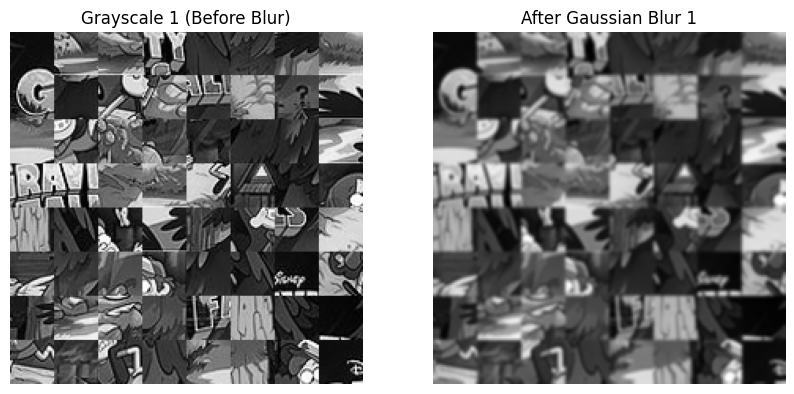

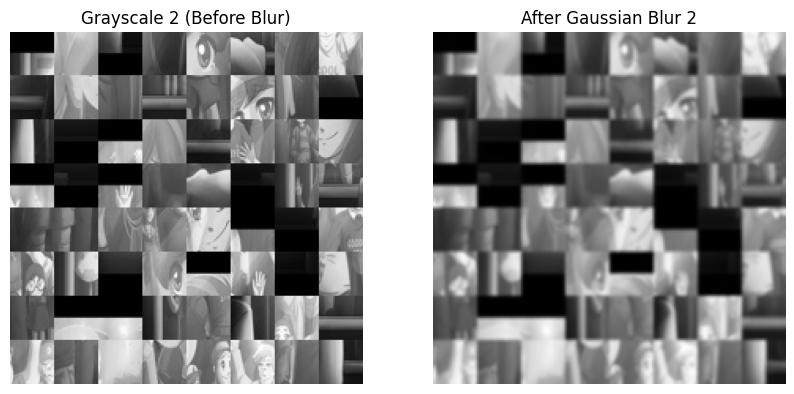

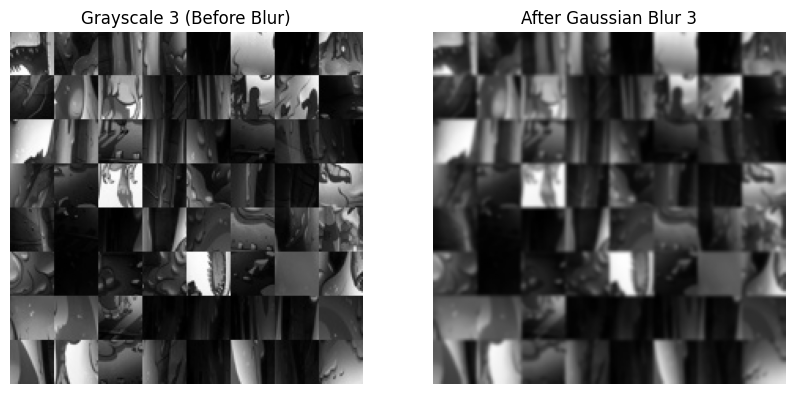

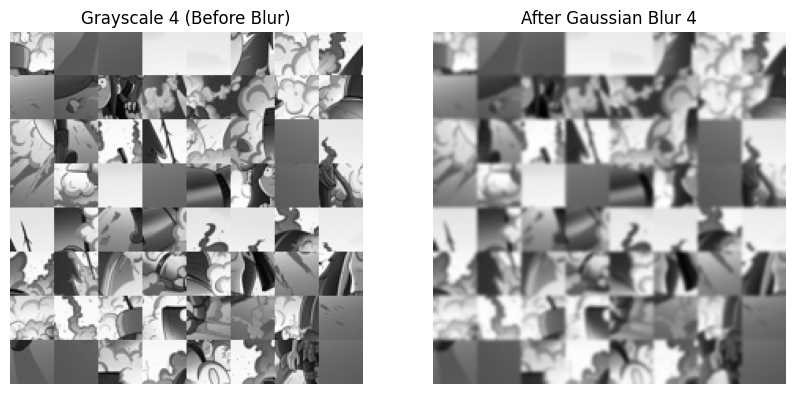

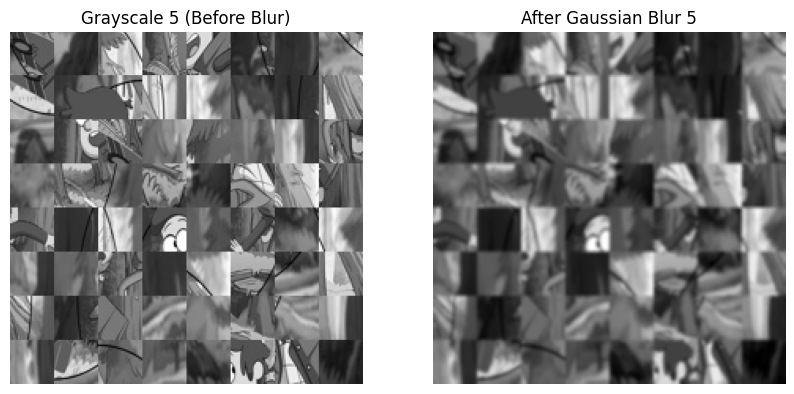

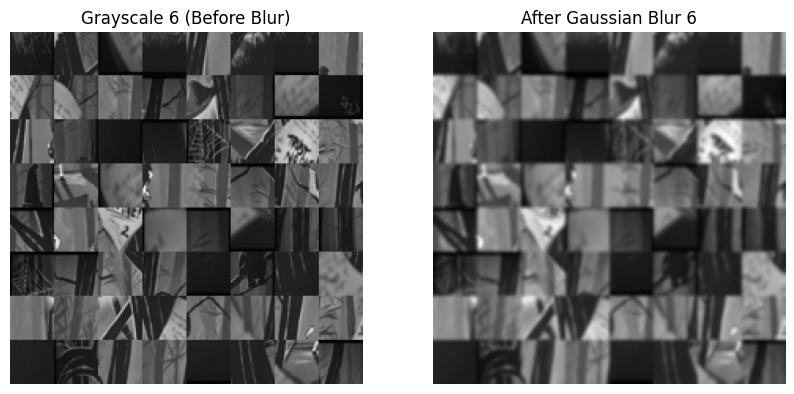

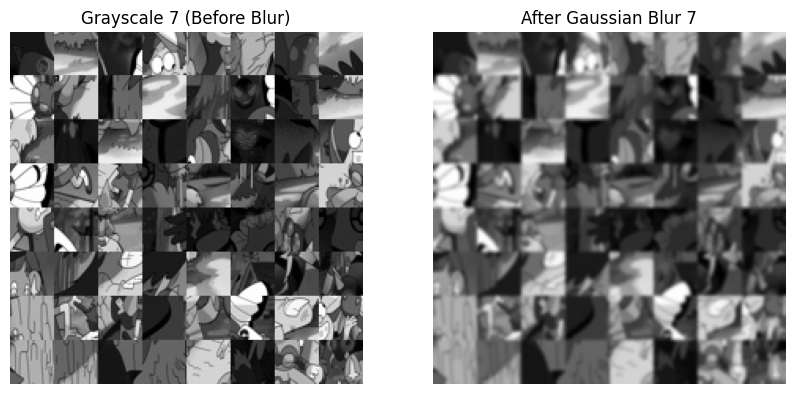

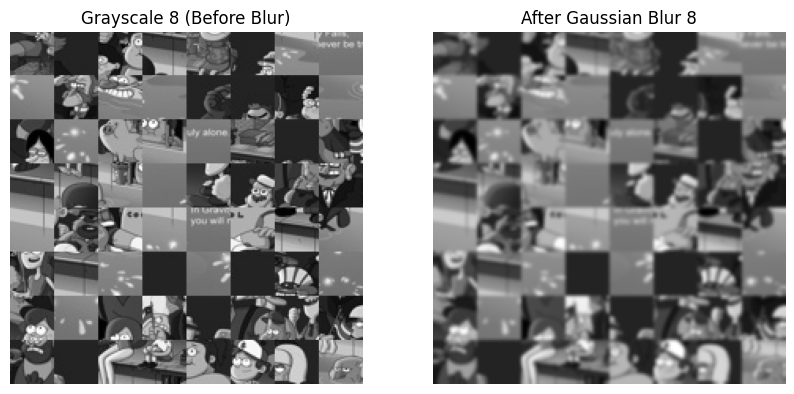

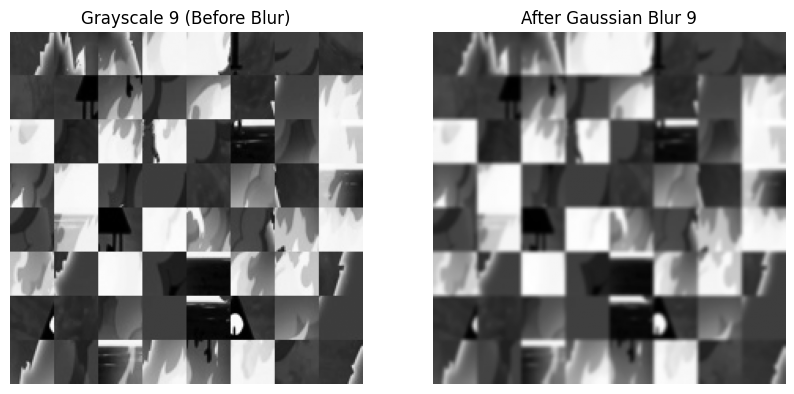

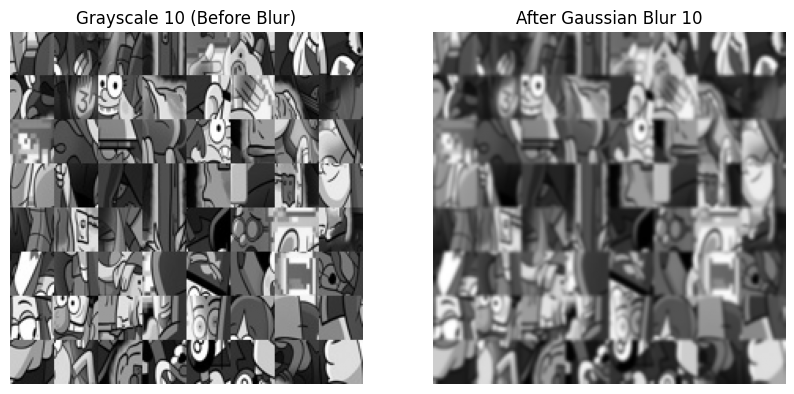

In [ ]:
import matplotlib.pyplot as plt

for i in range(10):
    original = grayscale_images[i]  # grayscale before blur
    blurred = gaussian_images[i]    # after Gaussian blur

    plt.figure(figsize=(10,5))

    plt.subplot(1,2,1)
    plt.imshow(original, cmap="gray")
    plt.title(f"Grayscale {i+1} (Before Blur)")
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.imshow(blurred, cmap="gray")
    plt.title(f"After Gaussian Blur {i+1}")
    plt.axis("off")

    plt.show()


In [ ]:
edges_images = []

# Canny thresholds
threshold1 = 50
threshold2 = 150

for blur in gaussian_images:
    edges = cv2.Canny(blur, threshold1, threshold2)
    edges_images.append(edges)

print(f"Total images after Canny edge detection: {len(edges_images)}")


Total images after Canny edge detection: 110


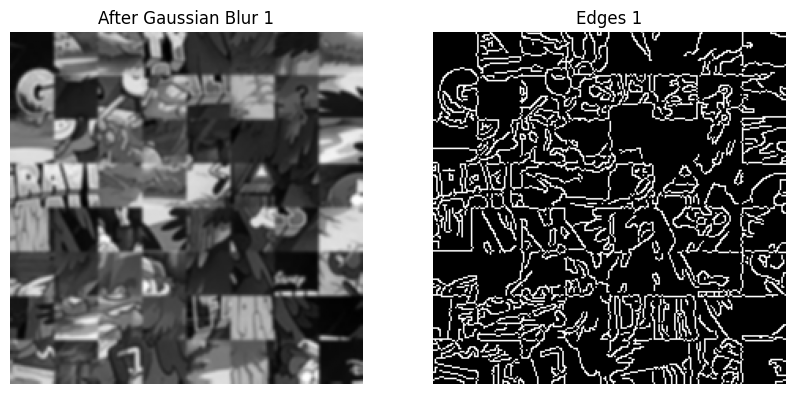

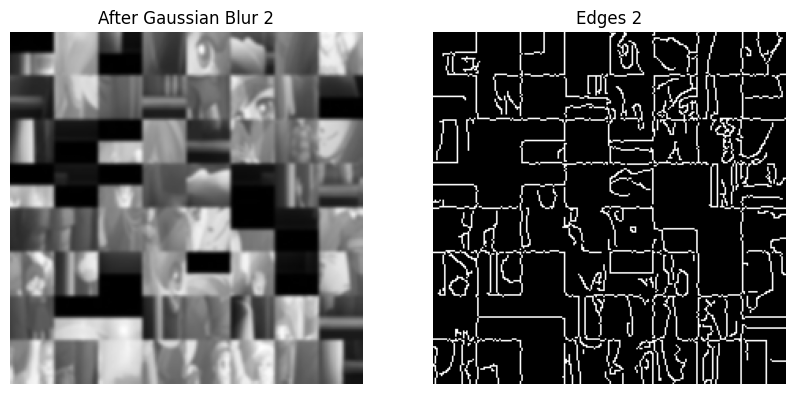

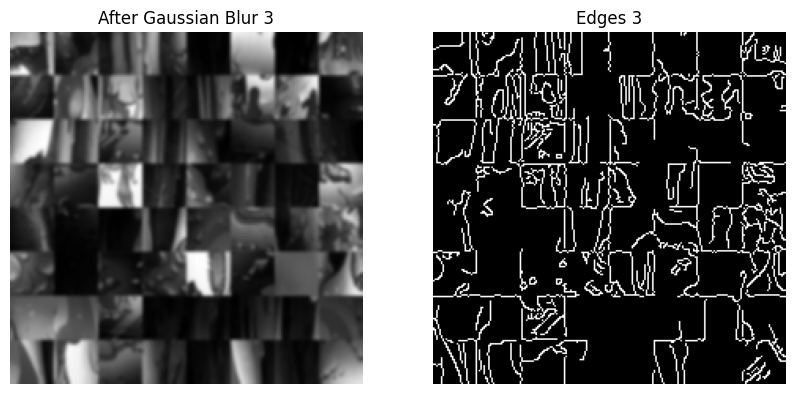

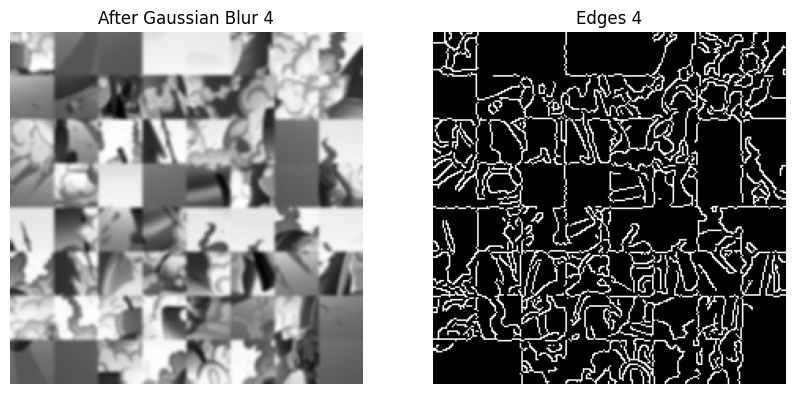

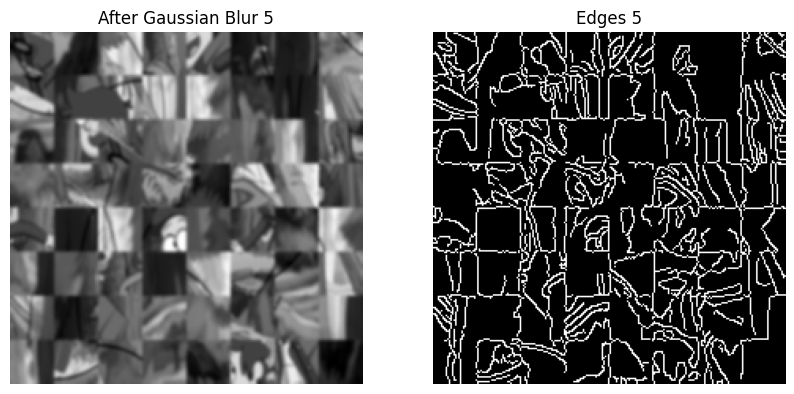

In [ ]:
import matplotlib.pyplot as plt

for i in range(5):
    blurred = gaussian_images[i]  # before edge detection
    edges = edges_images[i]        # after edge detection

    plt.figure(figsize=(10,5))

    plt.subplot(1,2,1)
    plt.imshow(blurred, cmap="gray")
    plt.title(f"After Gaussian Blur {i+1}")
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.imshow(edges, cmap="gray")
    plt.title(f"Edges {i+1}")
    plt.axis("off")

    plt.show()


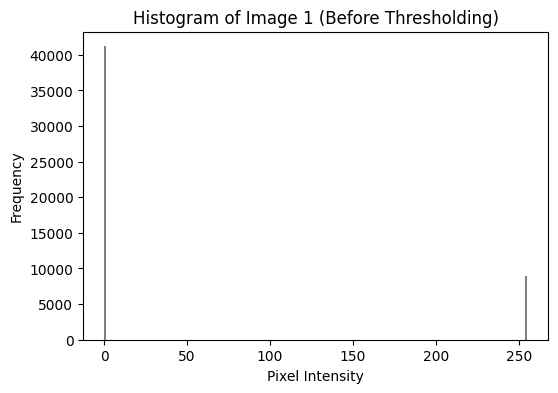

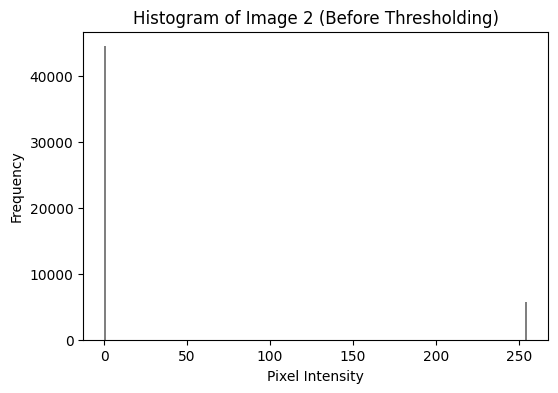

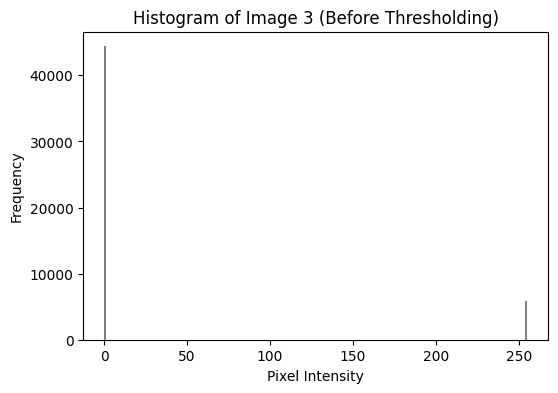

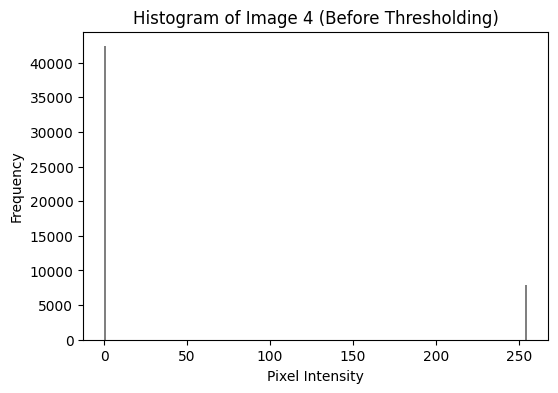

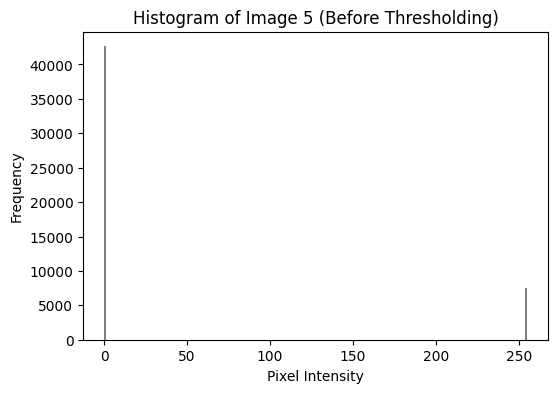

In [ ]:
for i in range(5):
    edges = edges_images[i]

    plt.figure(figsize=(6,4))
    plt.hist(edges.ravel(), bins=256, range=(0,255), color='gray')
    plt.title(f"Histogram of Image {i+1} (Before Thresholding)")
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Frequency")
    plt.show()


In [ ]:
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

In [ ]:
len(contours)

123

In [ ]:
areas = [cv2.contourArea(c) for c in contours]

In [ ]:
print(areas)

[1.5, 0.5, 7.5, 2.0, 1.0, 2.5, 0.0, 4.5, 0.0, 0.0, 2.5, 29.0, 0.5, 0.0, 27.5, 23.0, 5.0, 2.0, 2.0, 1.0, 28.5, 7.0, 170.0, 29.0, 3.0, 65.0, 0.0, 4.5, 7.5, 3.0, 10.5, 109.0, 0.0, 49.0, 0.0, 1.5, 1.5, 5.0, 1.0, 1.0, 22.0, 4.5, 0.0, 0.5, 7.5, 0.0, 0.5, 3.5, 1.0, 0.0, 4.5, 61.5, 37.0, 0.0, 7.5, 186.5, 11.0, 19.5, 4.5, 16.0, 339.5, 0.0, 11.0, 10.0, 5.0, 9.5, 0.5, 15.0, 6.0, 1.0, 23.5, 84.5, 0.0, 27.0, 1.0, 0.0, 15.5, 0.5, 4.0, 0.0, 1.5, 1.0, 0.0, 0.0, 260.0, 1.0, 4.5, 0.0, 4.5, 228.5, 27.5, 13.0, 0.0, 425.5, 0.5, 0.0, 2.0, 22.0, 7.5, 0.0, 1.0, 17.0, 1.0, 1.0, 3.0, 49.0, 10.5, 0.0, 45.0, 2.5, 20.5, 10.5, 15.5, 1.0, 47.5, 6.0, 6.5, 334.5, 7.0, 126.5, 25.5, 6.0, 10.5]


# Analysis
we Can already see that the images are wiggly and not suitable for contour extraction by just looking at image also we have two metrics to give an idea about our pipeline usability



1.   Number of Contours

OpenCV scans the binary edge image pixel-by-pixel and groups connected white pixels into a region.
Each region = one contour.
So:

 123 contours means:

Your processed image contains 123 separate connected white-edge regions.

That means the edges coming from your Canny + thresholding produced 123 disconnected pieces of edge



2.   Contour Areas

Large areas = big meaningful shapes

These are usually good contours.


Small areas = noise, tiny broken edges, artifacts

Small contour areas (like 2, 5, 12 pixels) indicate:

dust/noise left in the image
If you have 100 contours with area < 30 pixels → your image is not clean.



# **Actions to take**



1.   hyperparameter tuning
2.   using Morpholgical Operations to fix noise
3.   use different kernels or algorithms



User-Defined Functions

In [ ]:
# --- Function to apply Gaussian blur ---
def apply_gaussian(images, kernel_size=(5,5)):
    """
    Applies Gaussian blur to a list of grayscale images.

    Args:
        images (list): list of grayscale images (numpy arrays)
        kernel_size (tuple): kernel size for Gaussian blur

    Returns:
        list: blurred images
    """
    blurred_images = []
    for img in images:
        blurred = cv2.GaussianBlur(img, kernel_size, 0)
        blurred_images.append(blurred)
    return blurred_images

    # --- Function to apply Canny edge detection ---
def apply_canny(images, threshold1=50, threshold2=150):
    """
    Applies Canny edge detection to a list of images.

    Args:
        images (list): list of images (grayscale or blurred)
        threshold1 (int): min threshold
        threshold2 (int): max threshold

    Returns:
        list: edge-detected images
    """
    edges_list = []
    for img in images:
        edges = cv2.Canny(img, threshold1, threshold2)
        edges_list.append(edges)
    return edges_list


    # --- Function to find contours and compute metrics ---
def analyze_contours(edges_list):
    contours_metrics_images = []  # will store image with contours drawn
    metrics = []                  # list of (num_contours, avg_area)

    for edges in edges_list:
        # Find contours
        contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Compute metrics
        num_contours = len(contours)
        areas = [cv2.contourArea(c) for c in contours]
        avg_area = np.mean(areas) if areas else 0

        # Draw contours for visualization
        contour_img = cv2.cvtColor(edges, cv2.COLOR_GRAY2BGR)  # convert to color
        cv2.drawContours(contour_img, contours, -1, (0,255,0), 1)

        contours_metrics_images.append(contour_img)
        metrics.append((num_contours, avg_area))

    return contours_metrics_images, metrics

    # --- NEW: Function to compute contour metrics ---
def contour_metrics(edges_list):
    """
    Returns: list of (count, avg_area) for each image
    """
    metrics = []

    for edge_img in edges_list:
        contours, _ = cv2.findContours(edge_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        areas = [cv2.contourArea(c) for c in contours]

        count = len(contours)
        avg_area = np.mean(areas) if areas else 0

        metrics.append((count, avg_area))

    return metrics

# --- Function to apply Bilateral Filter ---
def apply_bilateral(images, d=9, sigmaColor=100, sigmaSpace=100):
    """
    Applies bilateral filtering to a list of grayscale images.

    Args:
        images (list): list of grayscale images
        d (int): diameter of pixel neighborhood
        sigmaColor (float): filter sigma in the color space
        sigmaSpace (float): filter sigma in the coordinate space

    Returns:
        list: filtered images
    """
    filtered_images = []
    for img in images:
        b = cv2.bilateralFilter(img, d, sigmaColor, sigmaSpace)
        filtered_images.append(b)
    return filtered_images


Testing 9x9 Guassian with 70,200 canny

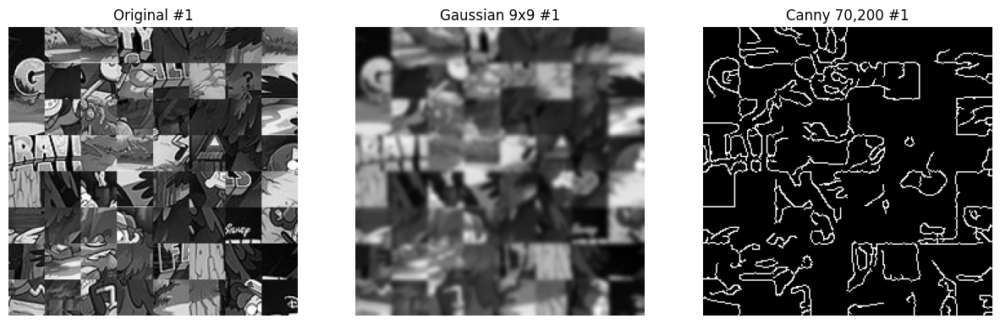

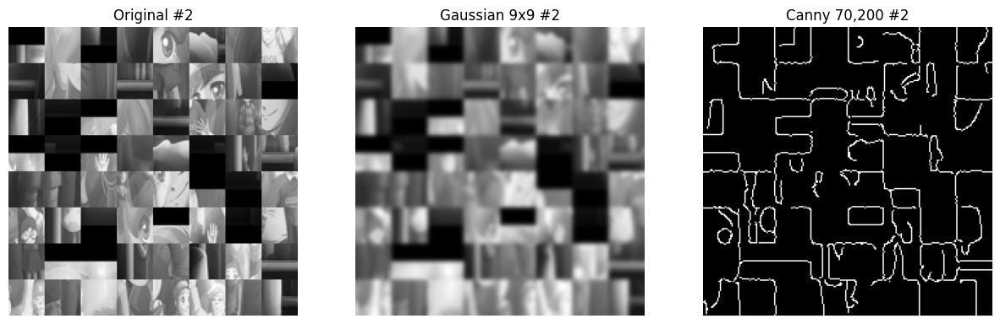

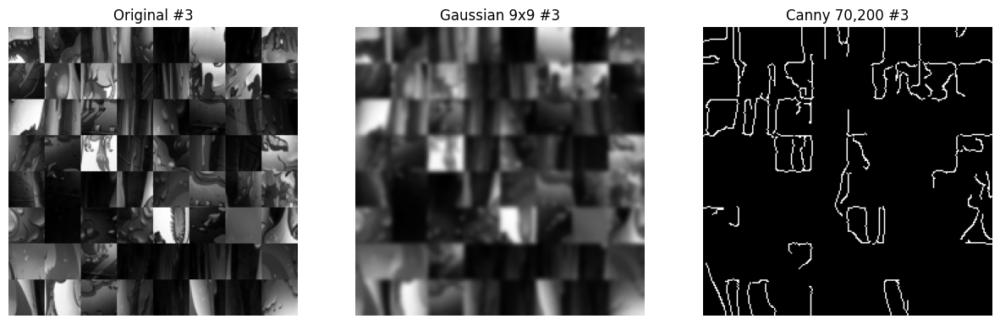

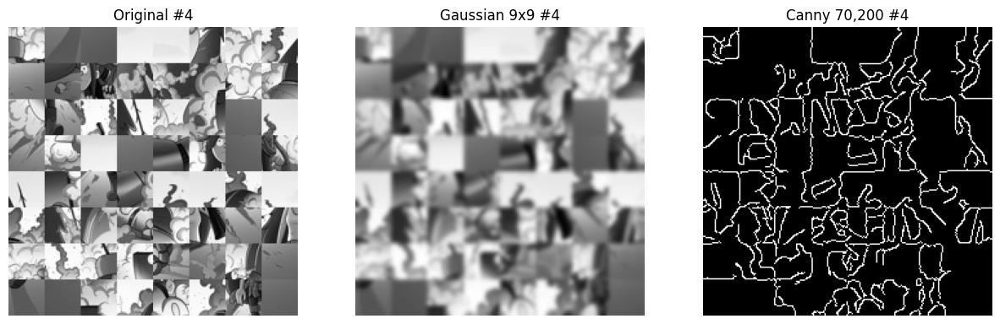

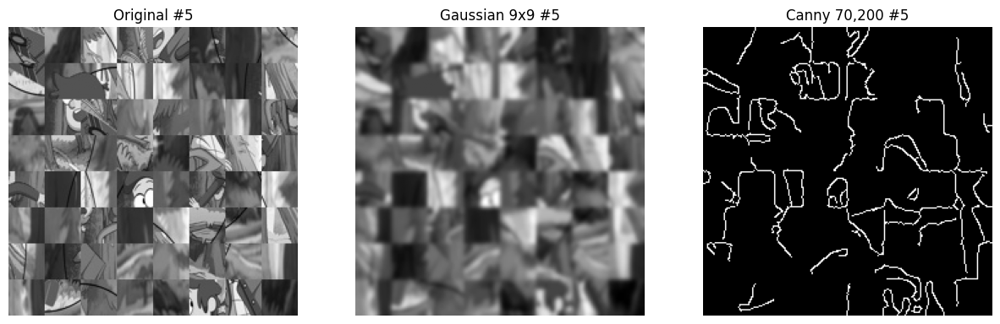

In [ ]:
# --- Call functions for testing ---

# Step 1: Apply 9x9 Gaussian on grayscale images
blurred_9x9 = apply_gaussian(grayscale_images, kernel_size=(9,9))

# Step 2: Apply Canny with thresholds 70,200
edges_9x9_70_200 = apply_canny(blurred_9x9, threshold1=70, threshold2=200)

# --- Display first 5 results ---
for i in range(5):
    original = grayscale_images[i]
    blurred  = blurred_9x9[i]
    edges    = edges_9x9_70_200[i]

    plt.figure(figsize=(15,5))

    plt.subplot(1,3,1)
    plt.imshow(original, cmap='gray')
    plt.title(f"Original #{i+1}")
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.imshow(blurred, cmap='gray')
    plt.title(f"Gaussian 9x9 #{i+1}")
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.imshow(edges, cmap='gray')
    plt.title(f"Canny 70,200 #{i+1}")
    plt.axis('off')

    plt.show()


# #              TEST GAUSSIAN 5×5 + multiple CANNY



Testing Canny 30, 100


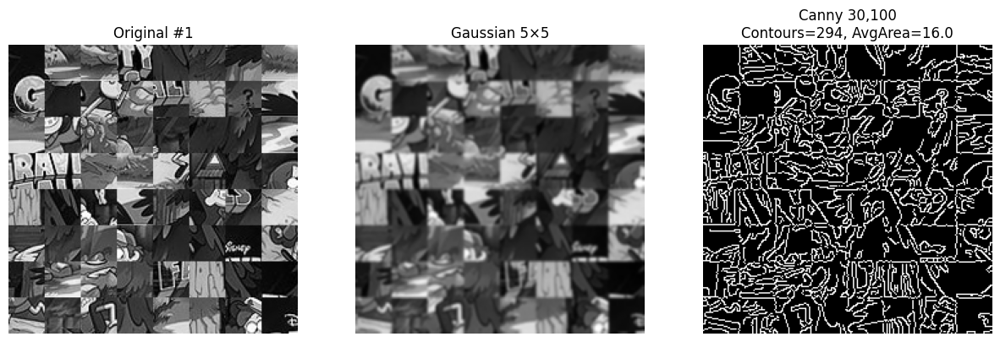

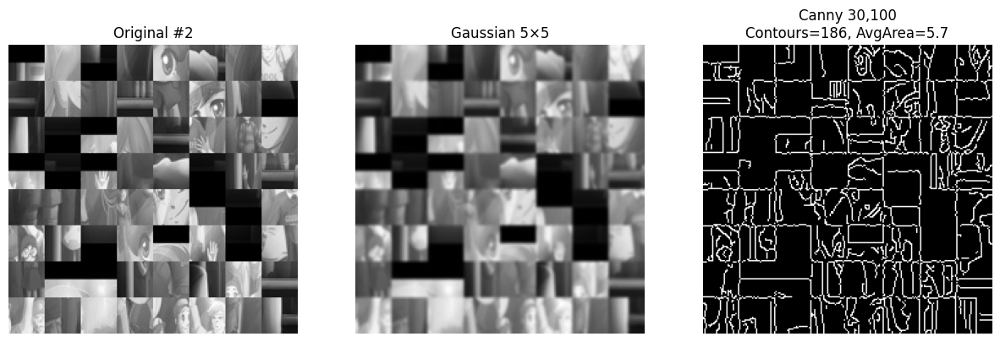

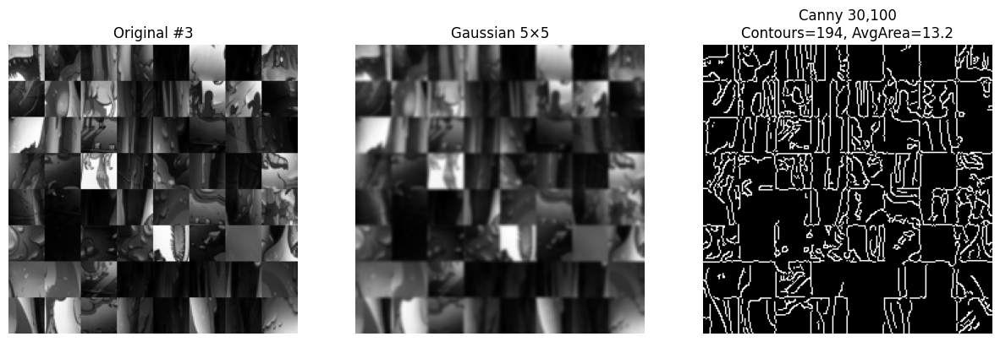

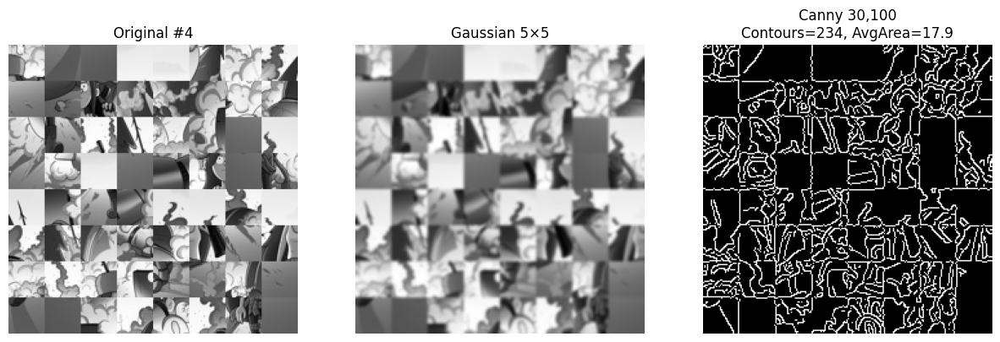

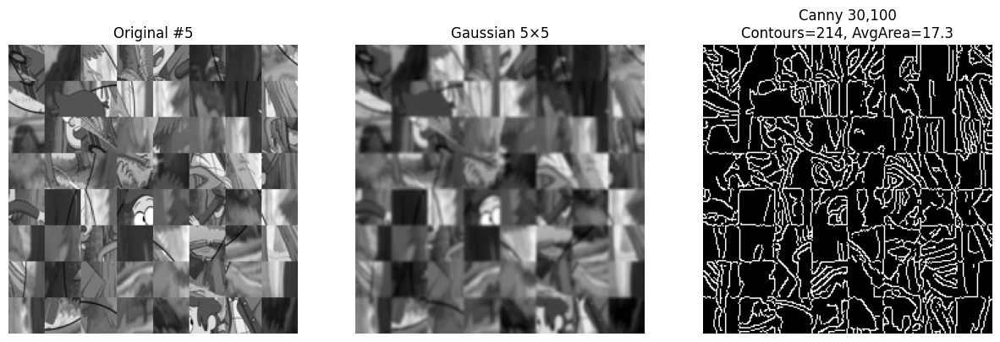


Testing Canny 40, 120


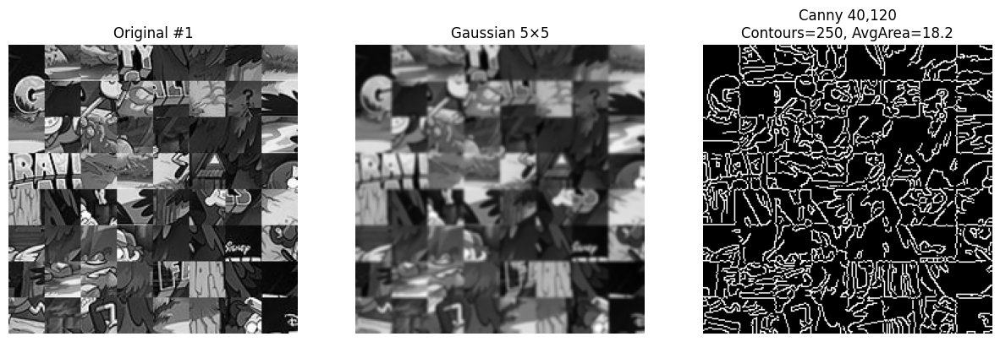

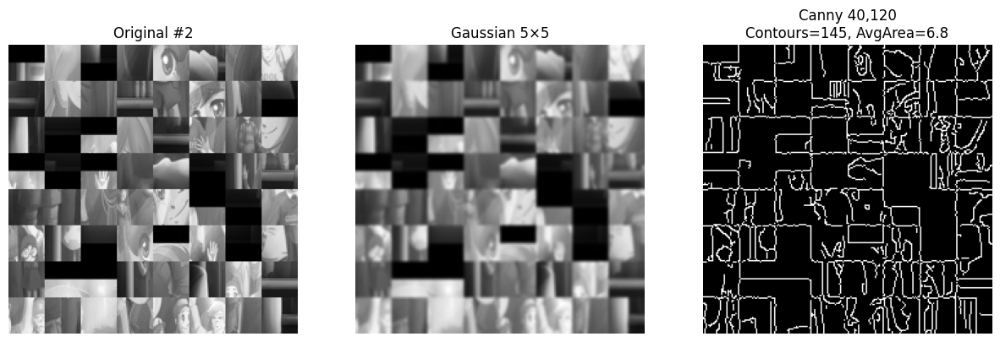

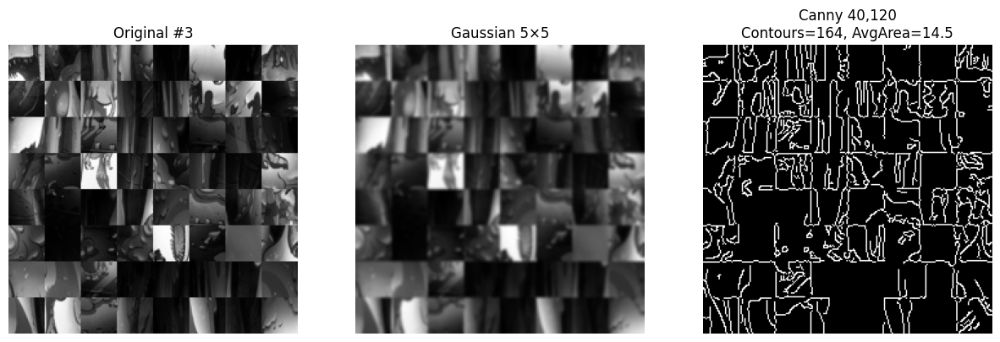

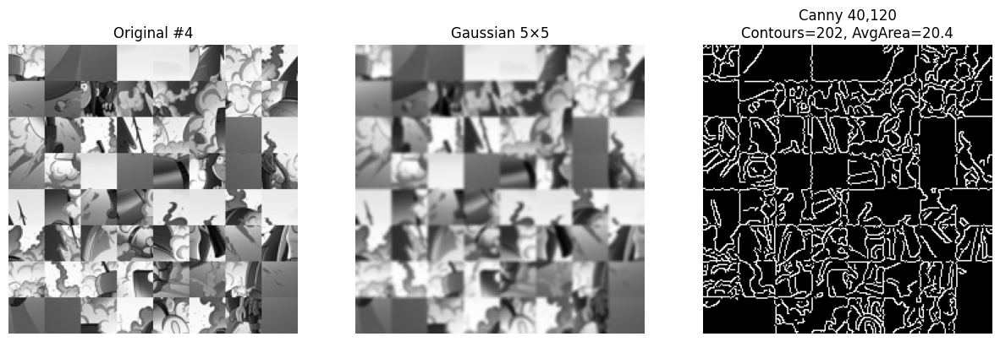

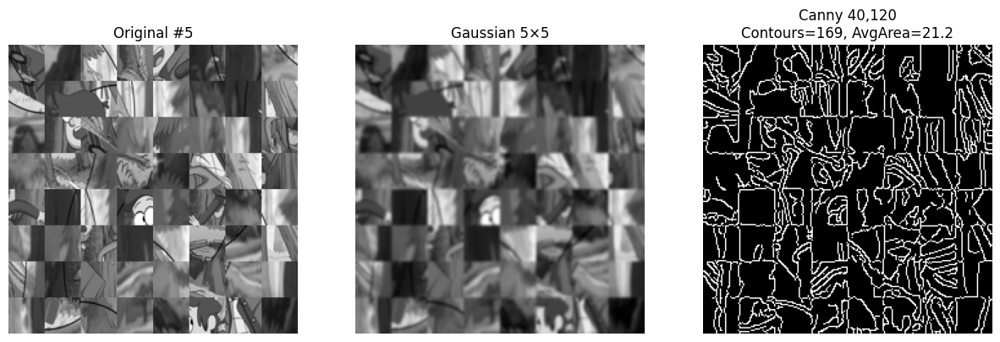


Testing Canny 50, 150


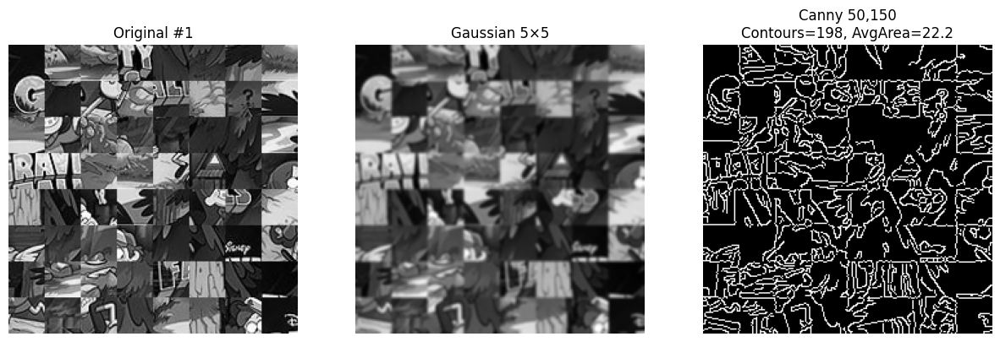

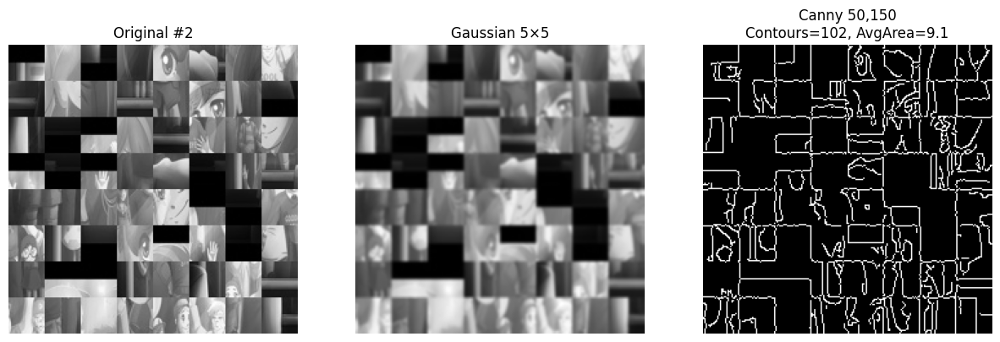

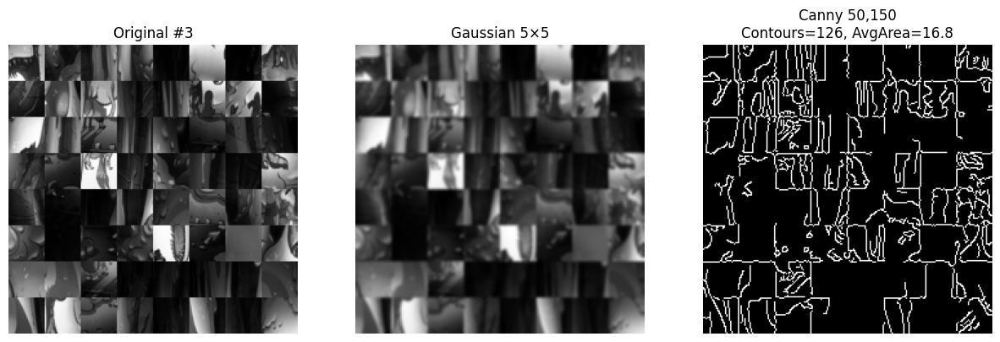

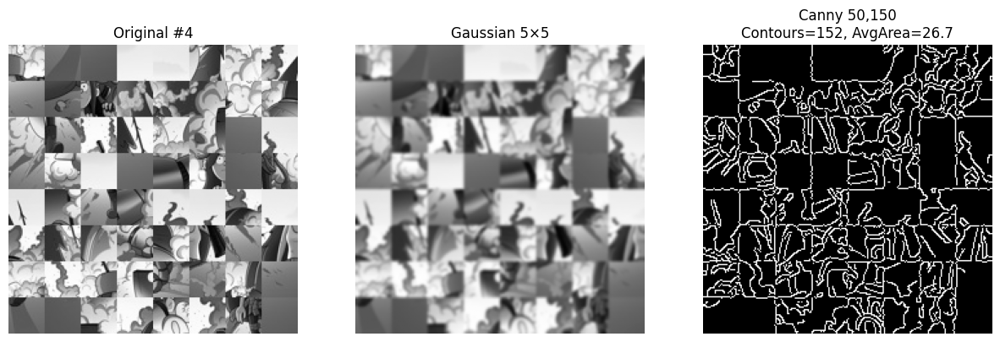

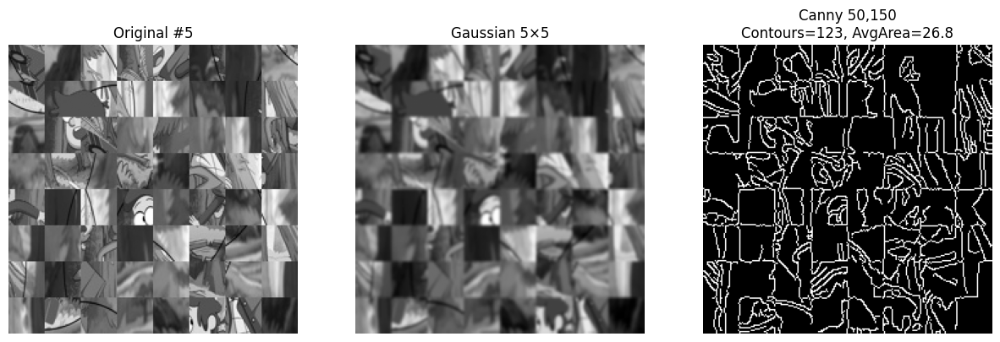


Testing Canny 70, 200


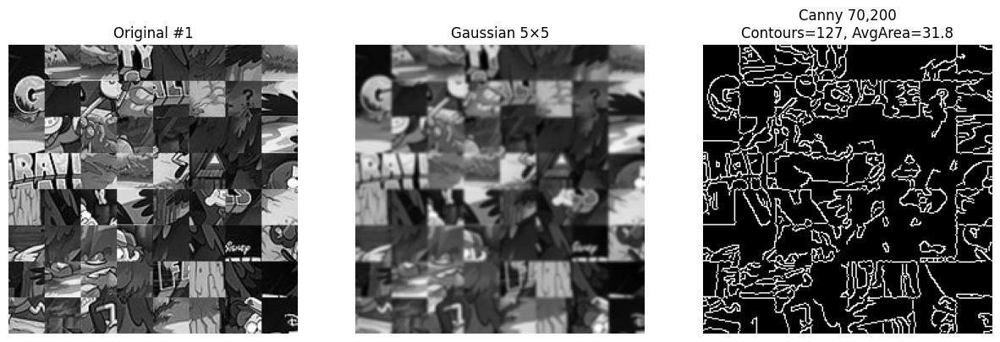

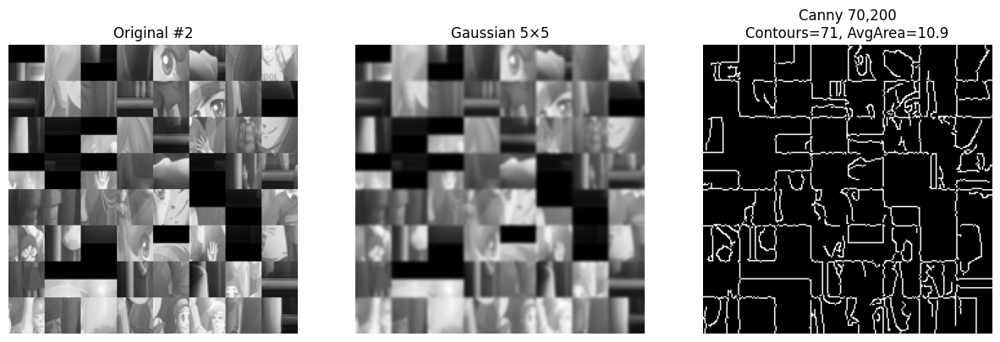

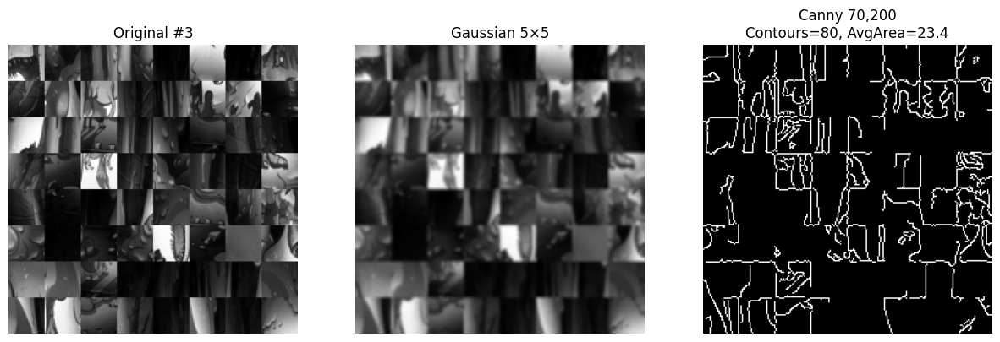

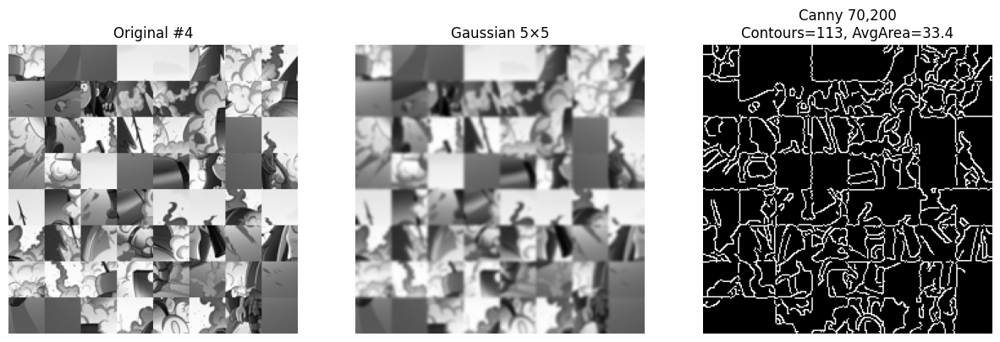

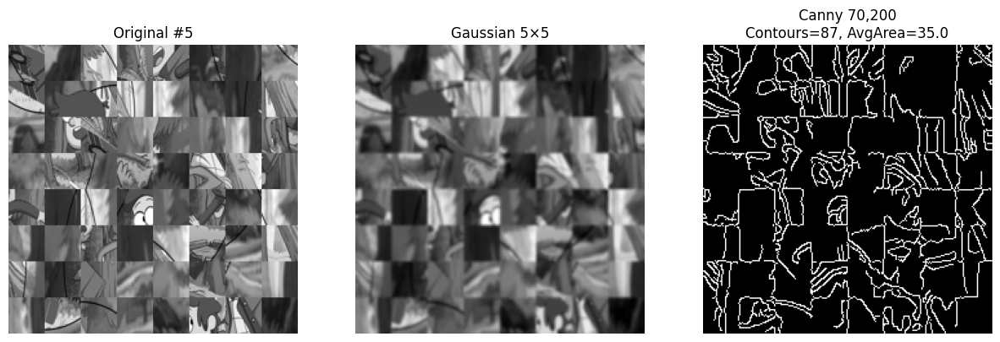


Testing Canny 90, 220


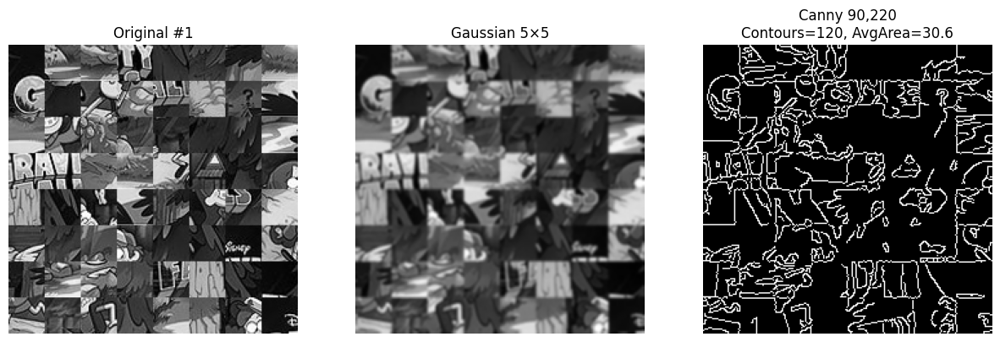

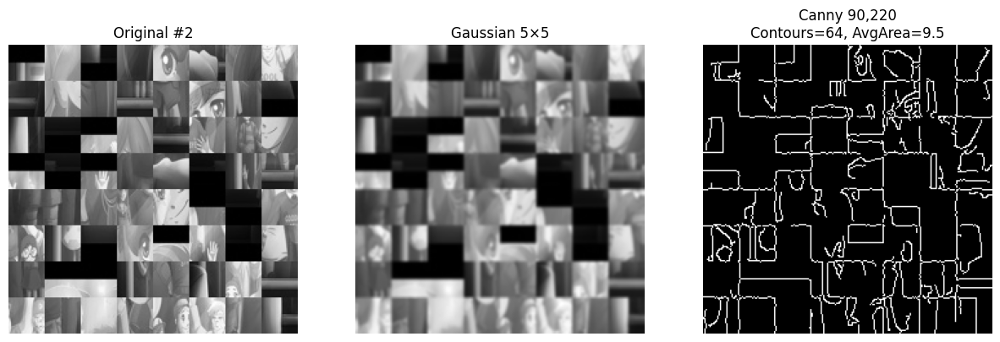

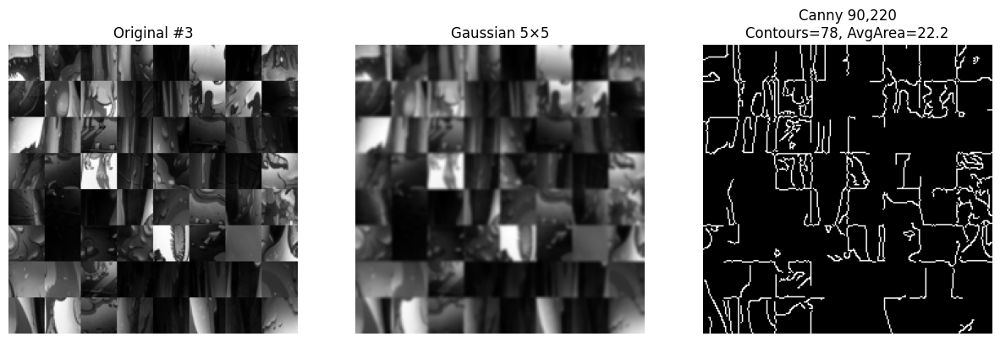

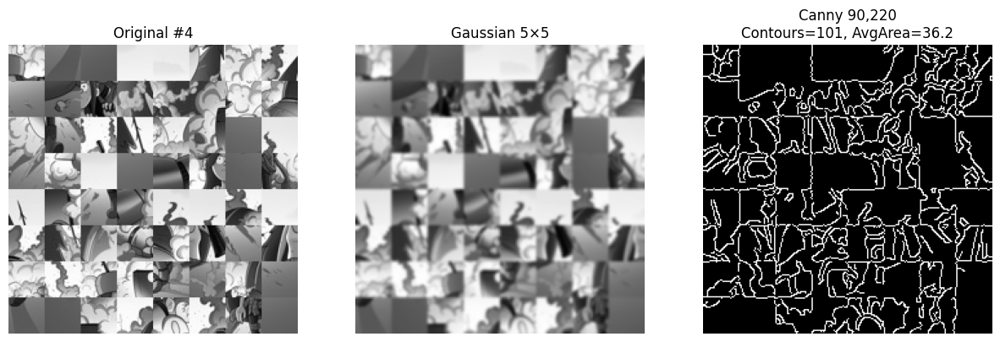

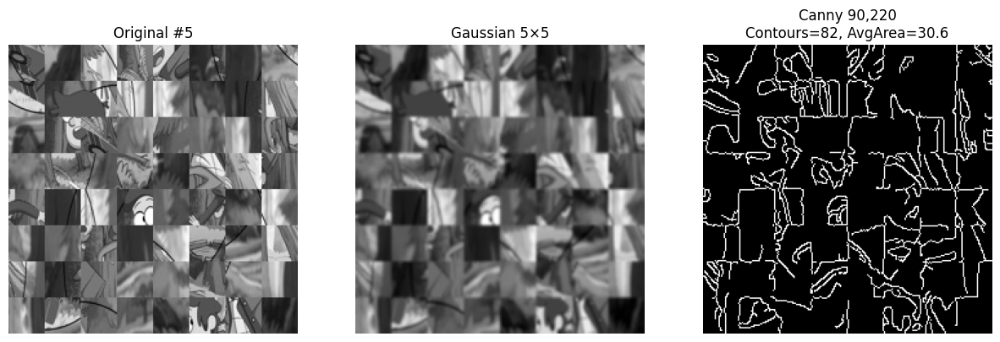

In [ ]:
# ======================================================
#              TEST GAUSSIAN 5×5 + multiple CANNY
# ======================================================

# Define thresholds you want to test
threshold_pairs = [
    (30, 100),
    (40, 120),
    (50, 150),
    (70, 200),
    (90, 220)
]

# Apply Gaussian 5x5 once
blurred_5x5 = apply_gaussian(grayscale_images, kernel_size=(5,5))

# Loop over threshold pairs
for (t1, t2) in threshold_pairs:
    print(f"\n====================")
    print(f"Testing Canny {t1}, {t2}")
    print("====================")

    # Apply canny for these thresholds
    edges_list = apply_canny(blurred_5x5, threshold1=t1, threshold2=t2)

    # Compute contour metrics
    metrics = contour_metrics(edges_list)

    # ---- Display first 5 images only ----
    for i in range(5):
        original = grayscale_images[i]
        blurred  = blurred_5x5[i]
        edges    = edges_list[i]

        count, avg_area = metrics[i]

        plt.figure(figsize=(15,5))

        plt.subplot(1,3,1)
        plt.imshow(original, cmap='gray')
        plt.title(f"Original #{i+1}")
        plt.axis('off')

        plt.subplot(1,3,2)
        plt.imshow(blurred, cmap='gray')
        plt.title("Gaussian 5×5")
        plt.axis('off')

        plt.subplot(1,3,3)
        plt.imshow(edges, cmap='gray')
        plt.title(f"Canny {t1},{t2}\nContours={count}, AvgArea={avg_area:.1f}")
        plt.axis('off')

        plt.show()


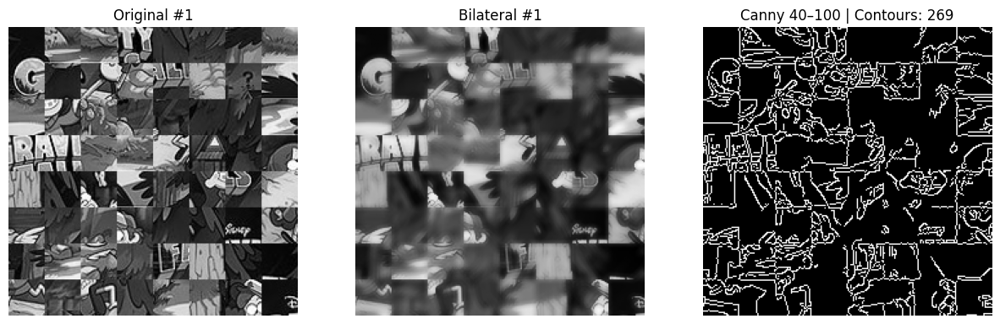

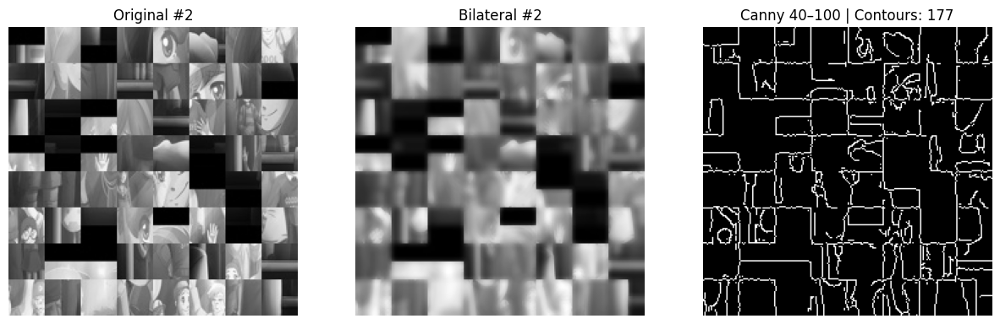

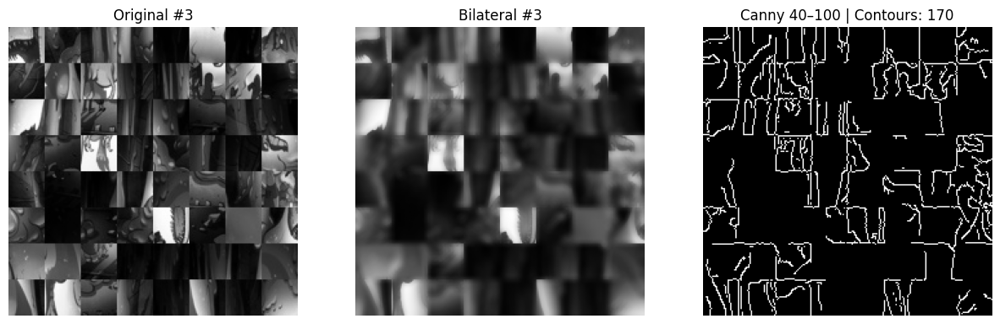

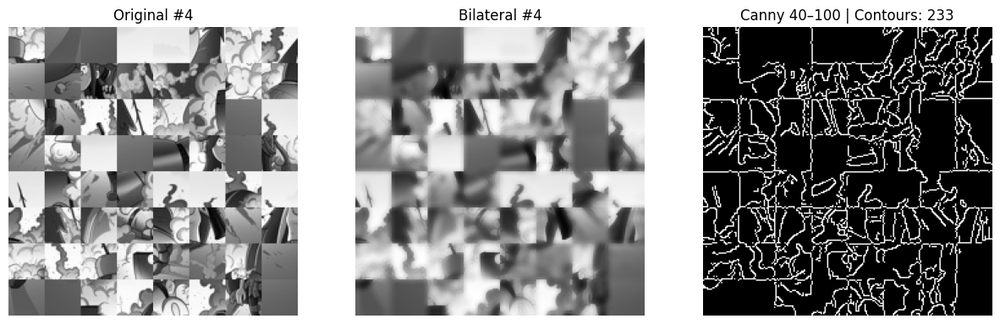

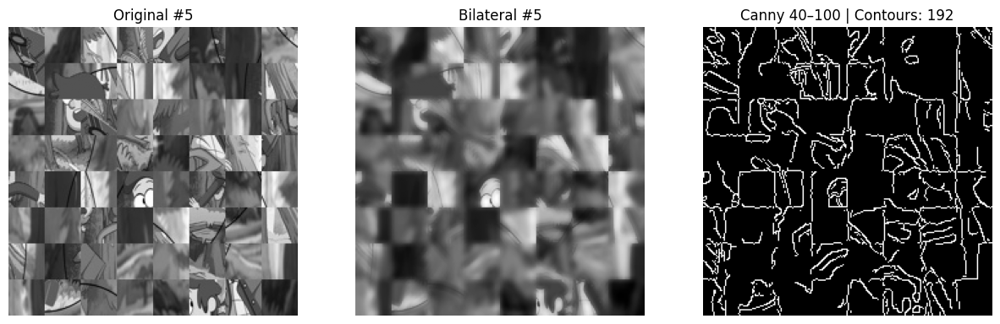

In [ ]:
# --- Test Bilateral + Canny ---
# 1. Apply bilateral filter
bilateral_images = apply_bilateral(grayscale_images, d=9, sigmaColor=100, sigmaSpace=100)

# 2. Apply Canny with thresholds you want
edges_bilateral_40_100 = apply_canny(bilateral_images, threshold1=40, threshold2=100)

# 3. Show first 5 images with contour count
for i in range(5):

    # --- Count contours for this image ---
    contours, _ = cv2.findContours(edges_bilateral_40_100[i], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    num_contours = len(contours)

    plt.figure(figsize=(15,5))

    plt.subplot(1,3,1)
    plt.imshow(grayscale_images[i], cmap='gray')
    plt.title(f"Original #{i+1}")
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.imshow(bilateral_images[i], cmap='gray')
    plt.title(f"Bilateral #{i+1}")
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.imshow(edges_bilateral_40_100[i], cmap='gray')
    plt.title(f"Canny 40–100 | Contours: {num_contours}")
    plt.axis('off')

    plt.show()


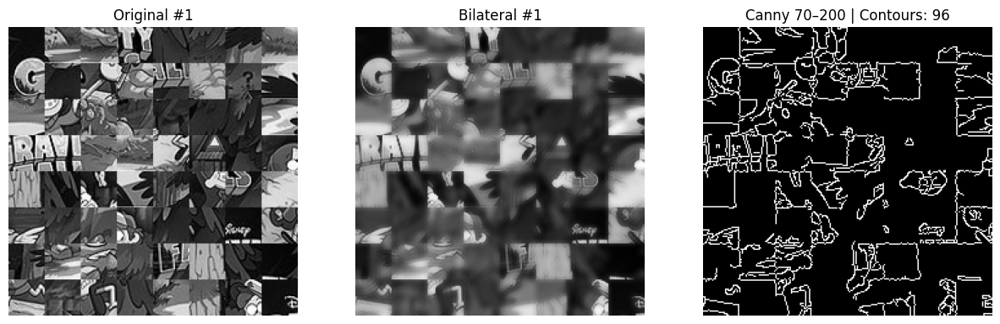

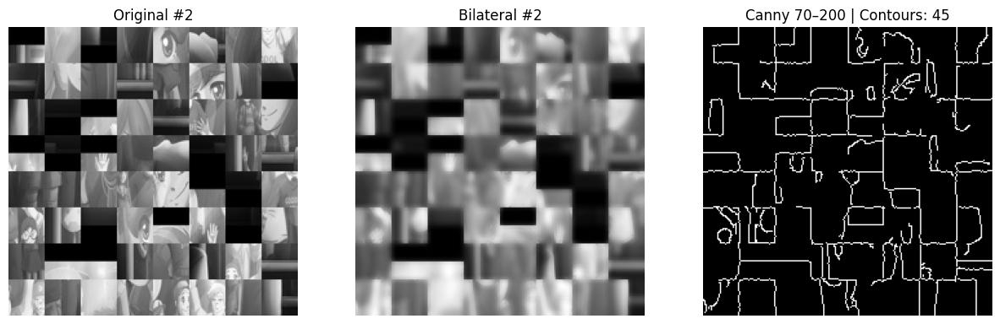

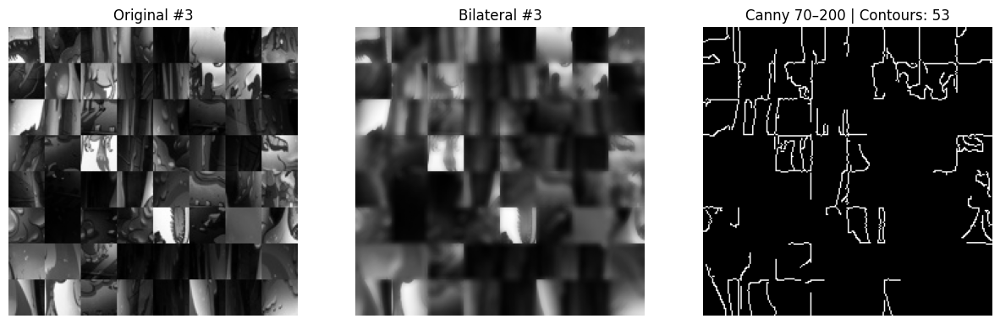

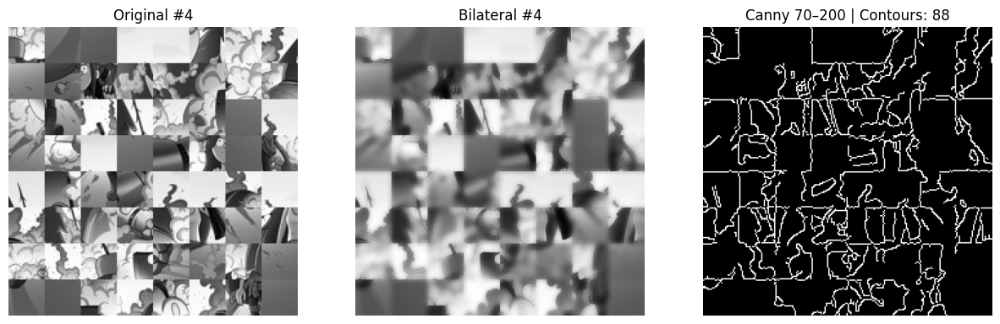

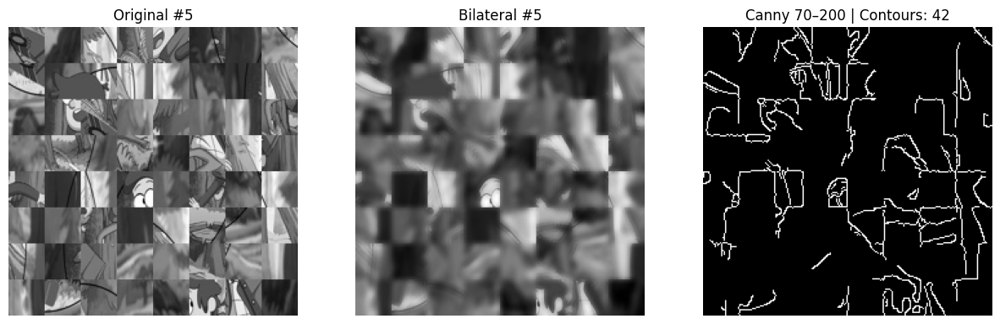

In [ ]:
# --- Test Bilateral + Canny ---
# 1. Apply bilateral filter
bilateral_images = apply_bilateral(grayscale_images, d=9, sigmaColor=100, sigmaSpace=100)

# 2. Apply Canny with thresholds you want
edges_bilateral_70_200 = apply_canny(bilateral_images, threshold1=70, threshold2=200)

# 3. Show first 5 images with contour count
for i in range(5):

    # --- Count contours for this image ---
    contours, _ = cv2.findContours(edges_bilateral_70_200[i], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    num_contours = len(contours)

    plt.figure(figsize=(15,5))

    plt.subplot(1,3,1)
    plt.imshow(grayscale_images[i], cmap='gray')
    plt.title(f"Original #{i+1}")
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.imshow(bilateral_images[i], cmap='gray')
    plt.title(f"Bilateral #{i+1}")
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.imshow(edges_bilateral_70_200[i], cmap='gray')
    plt.title(f"Canny 70–200 | Contours: {num_contours}")
    plt.axis('off')

    plt.show()


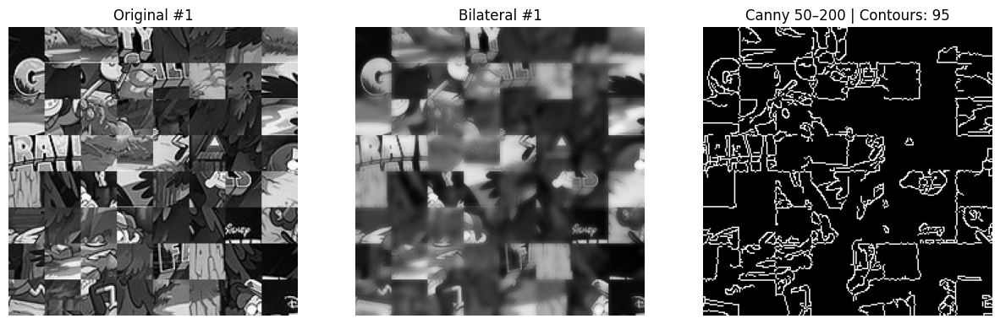

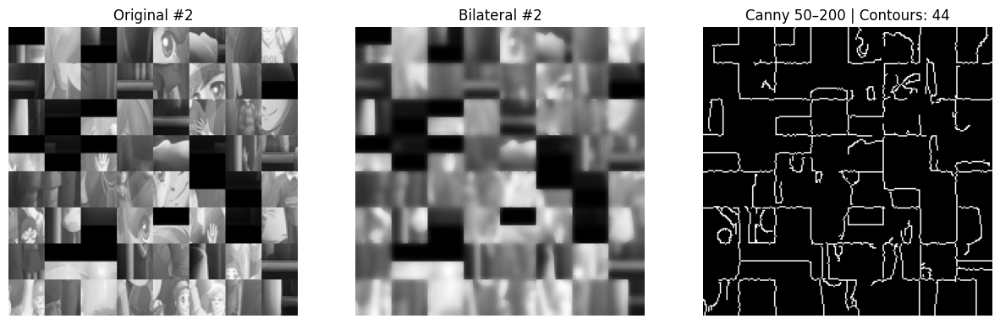

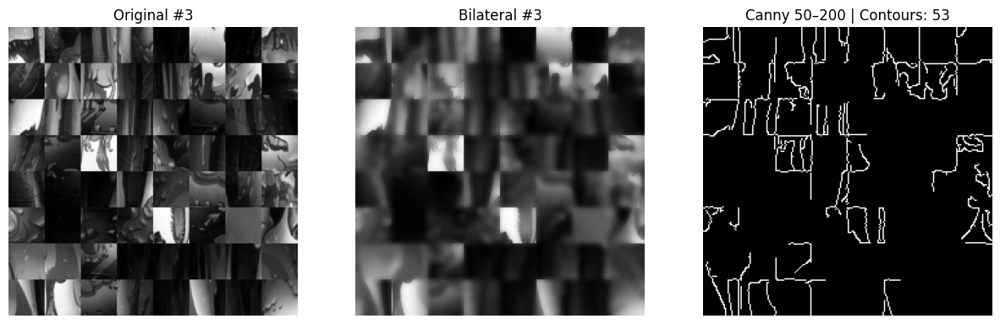

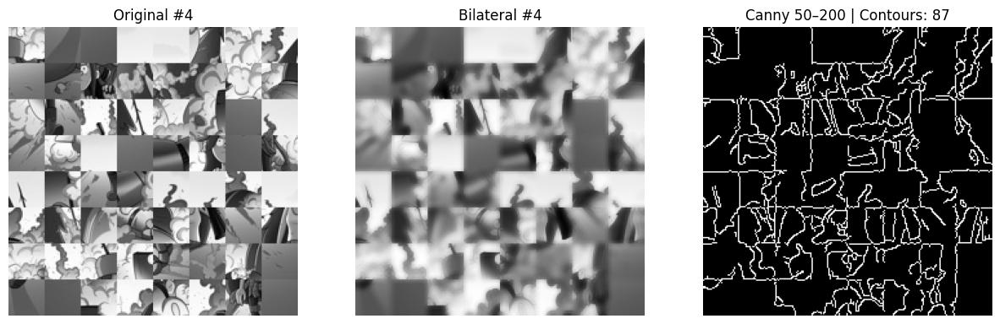

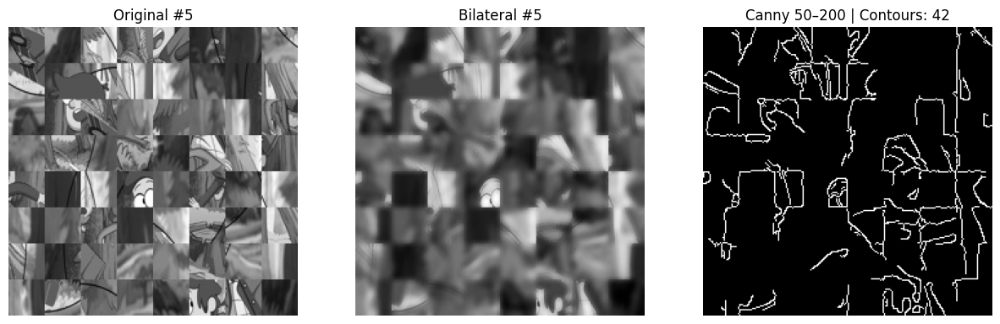

In [ ]:
# --- Test Bilateral + Canny ---
# 1. Apply bilateral filter
bilateral_images = apply_bilateral(grayscale_images, d=9, sigmaColor=100, sigmaSpace=100)

# 2. Apply Canny with thresholds you want
edges_bilateral_50_200 = apply_canny(bilateral_images, threshold1=50, threshold2=200)

# 3. Show first 5 images with contour count
for i in range(5):

    # --- Count contours for this image ---
    contours, _ = cv2.findContours(edges_bilateral_50_200[i], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    num_contours = len(contours)

    plt.figure(figsize=(15,5))

    plt.subplot(1,3,1)
    plt.imshow(grayscale_images[i], cmap='gray')
    plt.title(f"Original #{i+1}")
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.imshow(bilateral_images[i], cmap='gray')
    plt.title(f"Bilateral #{i+1}")
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.imshow(edges_bilateral_50_200[i], cmap='gray')
    plt.title(f"Canny 50–200 | Contours: {num_contours}")
    plt.axis('off')

    plt.show()


Canny uses a dual-threshold system where strong edges are detected using an upper threshold (T₂), while weak edges between the lower (T₁) and upper thresholds are included only if connected to strong edges through hysteresis. This prevents noise from being falsely detected while preserving thin or faint boundaries.

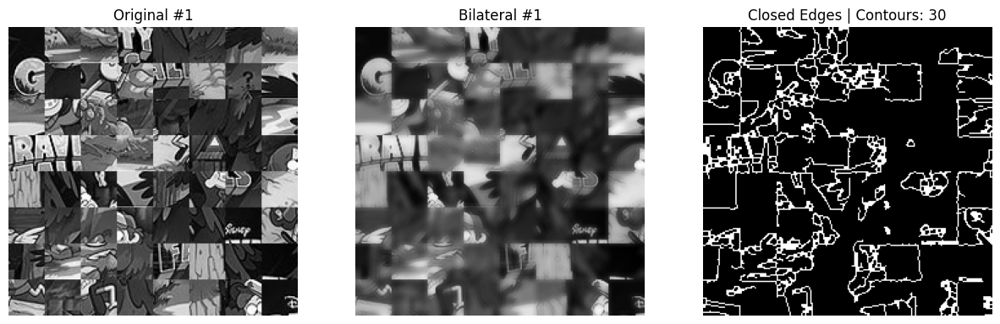

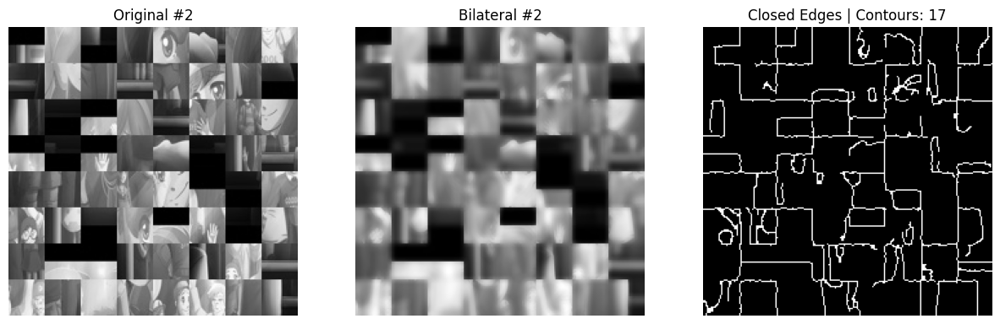

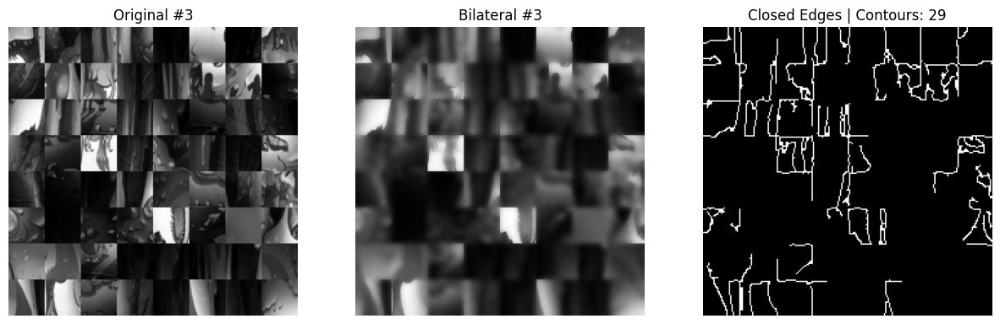

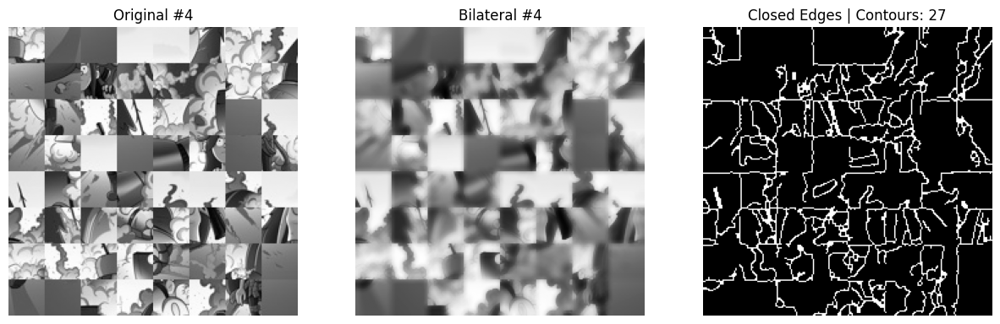

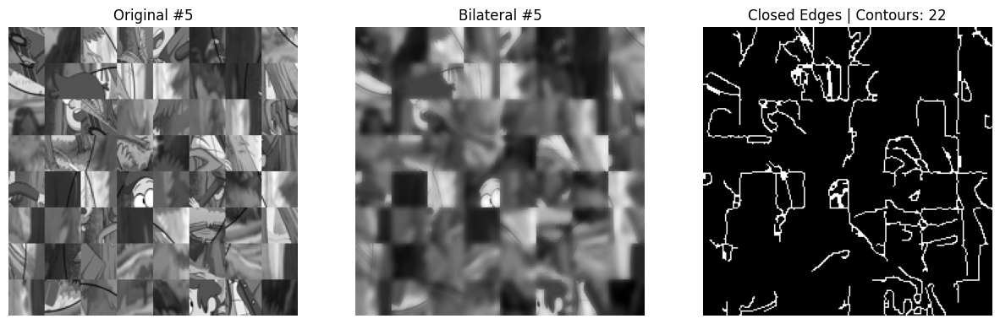

In [ ]:
# --- Step 1: Minor Closing to fill tiny gaps in edges ---
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))  # small kernel to avoid merging tiles
edges_closed = []

for i in range(len(edges_bilateral_50_200)):
    closed = cv2.morphologyEx(edges_bilateral_50_200[i], cv2.MORPH_CLOSE, kernel)
    edges_closed.append(closed)

    # Optional: visualize the first 5 images
    if i < 5:
        contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        num_contours = len(contours)

        plt.figure(figsize=(15,5))

        plt.subplot(1,3,1)
        plt.imshow(grayscale_images[i], cmap='gray')
        plt.title(f"Original #{i+1}")
        plt.axis('off')

        plt.subplot(1,3,2)
        plt.imshow(bilateral_images[i], cmap='gray')
        plt.title(f"Bilateral #{i+1}")
        plt.axis('off')

        plt.subplot(1,3,3)
        plt.imshow(closed, cmap='gray')
        plt.title(f"Closed Edges | Contours: {num_contours}")
        plt.axis('off')

        plt.show()


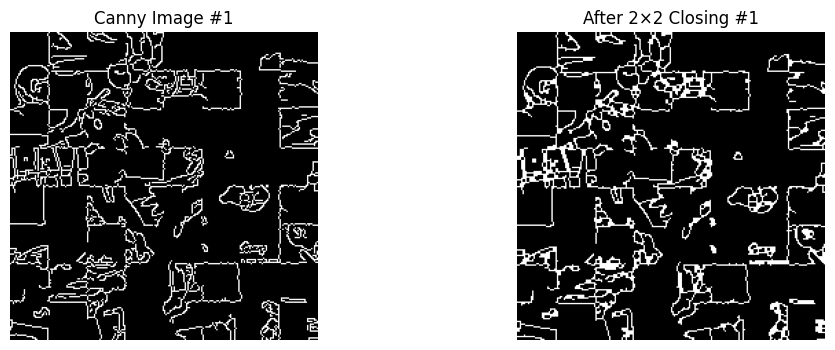

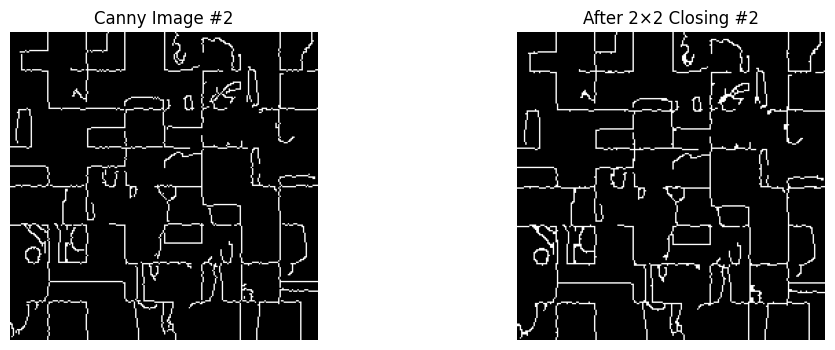

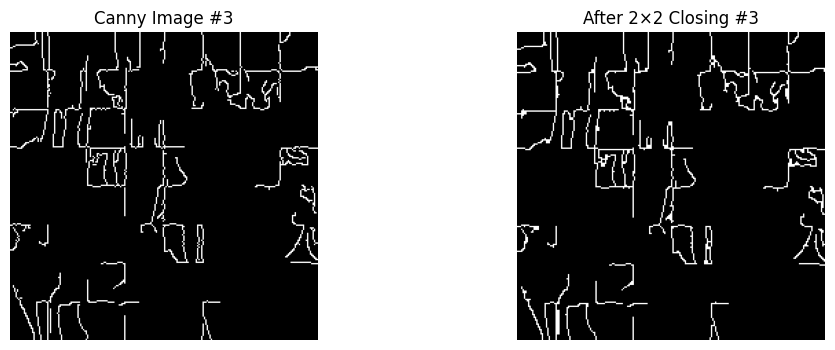

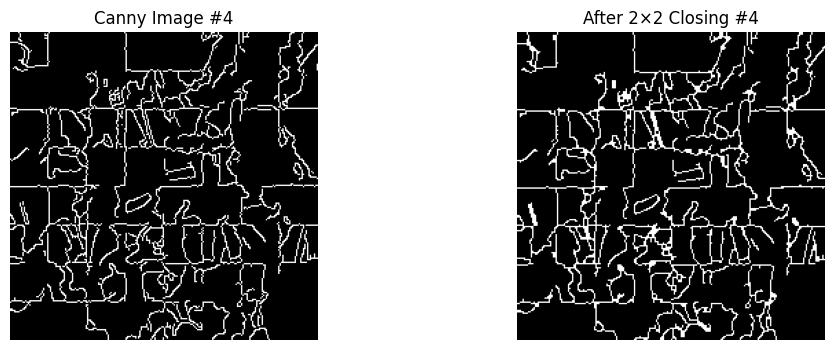

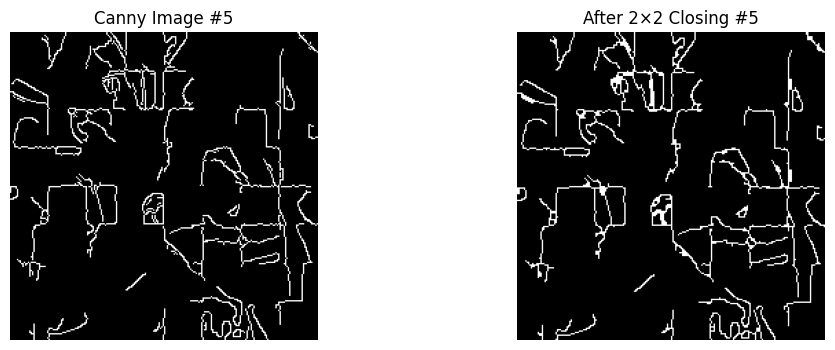

In [ ]:
# --- Step 2: Light Morphological Closing to Fix Tile Boundaries ---

# Small rectangular kernel (2x2) – enough to close tiny gaps but NOT merge tiles
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))

edges_closed = []

for i in range(len(edges_bilateral_70_200)):
    closed = cv2.morphologyEx(edges_bilateral_70_200[i], cv2.MORPH_CLOSE, kernel)
    edges_closed.append(closed)

edges_closed = np.array(edges_closed)

# Show first 5 results
for i in range(5):
    plt.figure(figsize=(12,4))

    plt.subplot(1,2,1)
    plt.imshow(edges_bilateral_70_200[i], cmap='gray')
    plt.title(f"Canny Image #{i+1}")
    plt.axis('off')

    plt.subplot(1,2,2)
    plt.imshow(edges_closed[i], cmap='gray')
    plt.title(f"After 2×2 Closing #{i+1}")
    plt.axis('off')

    plt.show()


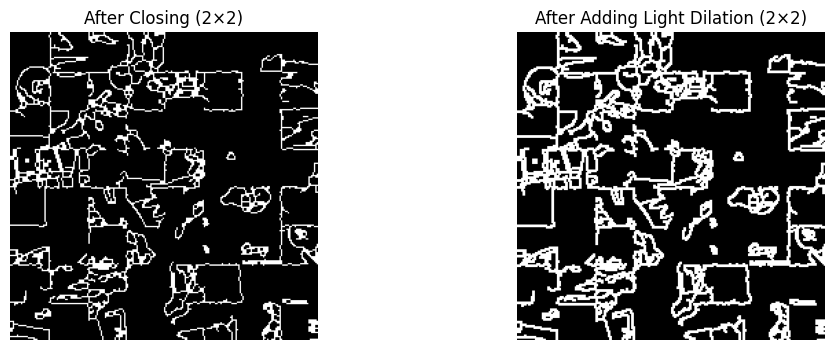

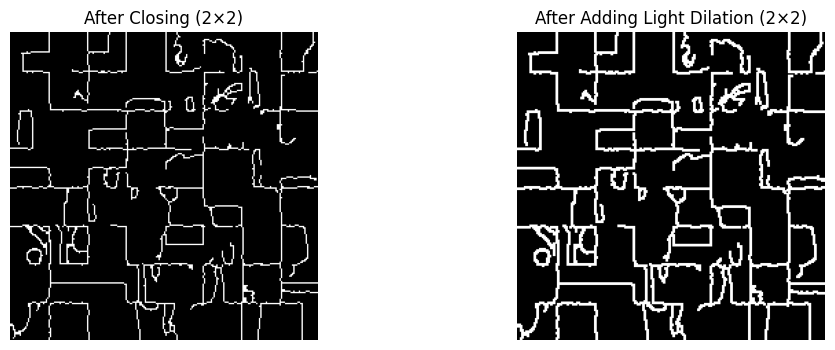

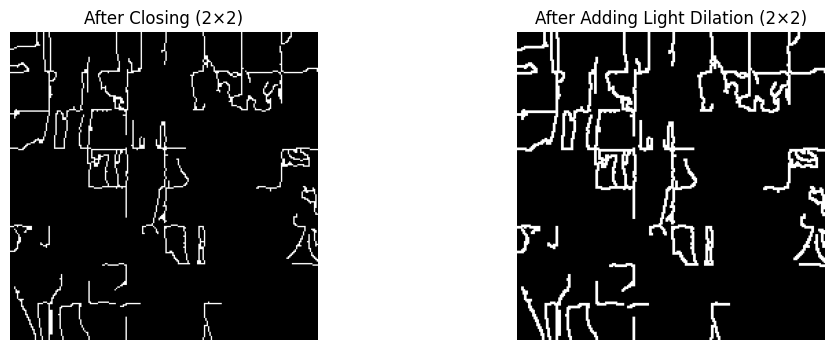

In [ ]:
# --- Step 4: Very Light Dilation to Strengthen Tile Borders ---
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 2))

edges_strong = []

for i in range(len(edges_closed)):
    dil = cv2.dilate(edges_closed[i], kernel, iterations=1)
    edges_strong.append(dil)

edges_strong = np.array(edges_strong)

# Show comparison for the first 3 images
for i in range(3):
    plt.figure(figsize=(12,4))

    plt.subplot(1,2,1)
    plt.imshow(edges_closed[i], cmap='gray')
    plt.title("After Closing (2×2)")
    plt.axis('off')

    plt.subplot(1,2,2)
    plt.imshow(edges_strong[i], cmap='gray')
    plt.title("After Adding Light Dilation (2×2)")
    plt.axis('off')

    plt.show()



--- Image #0 ---
Contours detected: 26


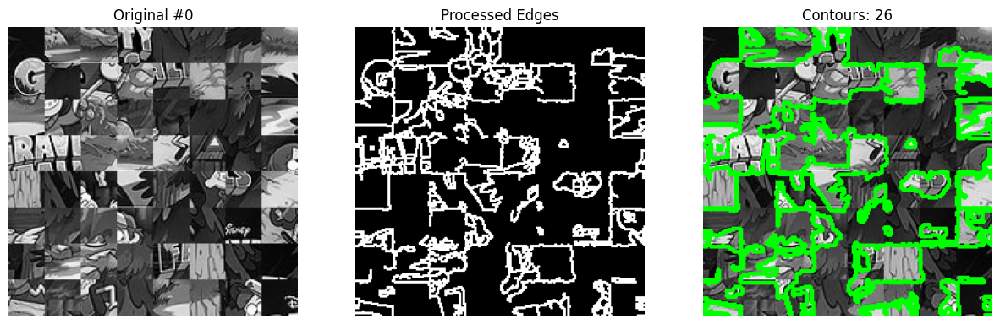


--- Image #1 ---
Contours detected: 17


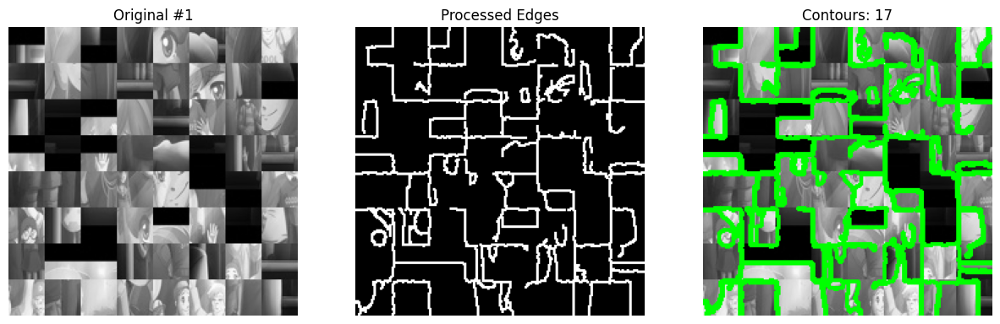


--- Image #2 ---
Contours detected: 28


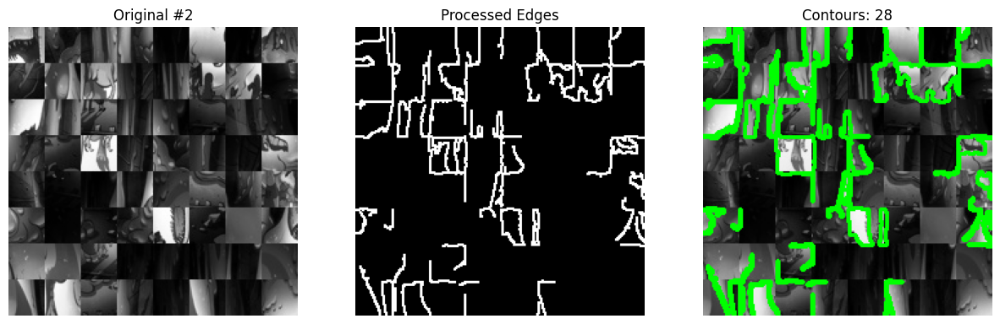


--- Image #3 ---
Contours detected: 13


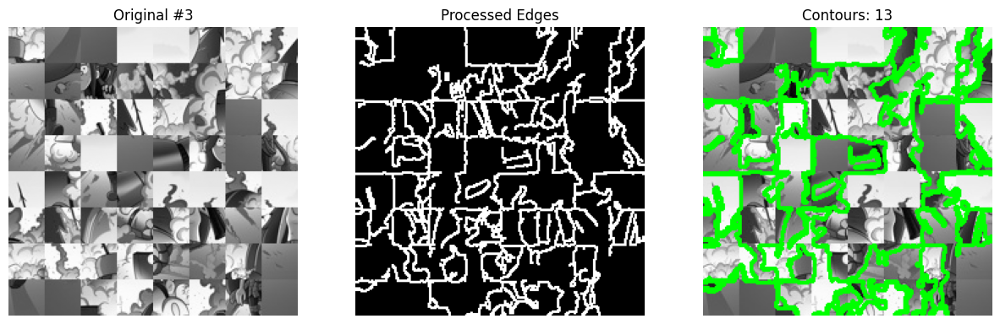


--- Image #4 ---
Contours detected: 20


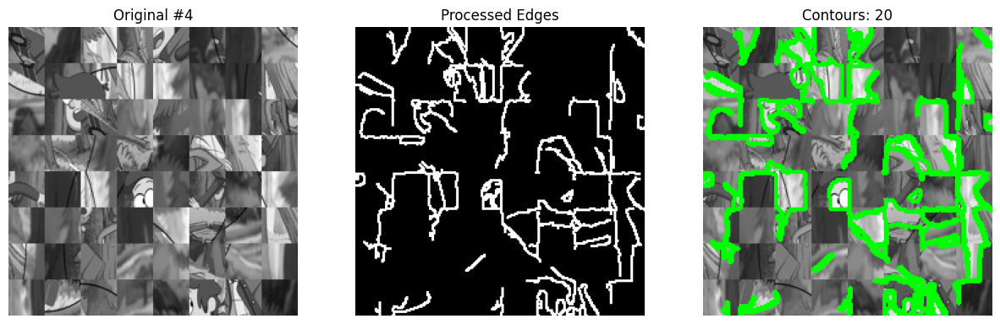

In [ ]:
# --- Step X: Contour Extraction for First 5 Images ---

for i in range(5):   # visualize images 0,1,2,3,4

    print(f"\n--- Image #{i} ---")

    # 1. Get the processed edge image (after Canny + morphology)
    edge_image = edges_strong[i]   # use your final edge variable

    # 2. Extract contours
    contours, hierarchy = cv2.findContours(
        edge_image.copy(),
        cv2.RETR_EXTERNAL,        # only external contours
        cv2.CHAIN_APPROX_SIMPLE
    )

    num_contours = len(contours)
    print("Contours detected:", num_contours)

    # 3. Visualize contours on original
    contour_vis = cv2.cvtColor(grayscale_images[i], cv2.COLOR_GRAY2BGR)
    cv2.drawContours(contour_vis, contours, -1, (0,255,0), 2)

    # 4. Plot results
    plt.figure(figsize=(15,5))

    plt.subplot(1,3,1)
    plt.imshow(grayscale_images[i], cmap='gray')
    plt.title(f"Original #{i}")
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.imshow(edge_image, cmap='gray')
    plt.title("Processed Edges")
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.imshow(contour_vis)
    plt.title(f"Contours: {num_contours}")
    plt.axis('off')

    plt.show()


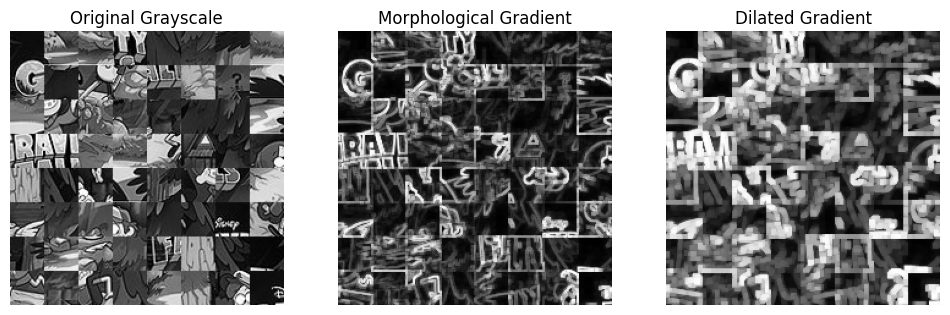

In [ ]:
i = 0  # choose the image index you want to test

# 1. Get your processed grayscale image (before Canny)
gray_image = grayscale_images[i]  # assuming you already have this

# 2. Define a kernel for morphological gradient
kernel = np.ones((3, 3), np.uint8)  # you can try 3x3, 5x5

# 3. Apply morphological gradient
morph_grad = cv2.morphologyEx(gray_image, cv2.MORPH_GRADIENT, kernel)

# 4. Optional: dilate to make edges more visible / connected
morph_dilated = cv2.dilate(morph_grad, kernel, iterations=1)

# 5. Display results
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.imshow(gray_image, cmap='gray')
plt.title("Original Grayscale")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(morph_grad, cmap='gray')
plt.title("Morphological Gradient")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(morph_dilated, cmap='gray')
plt.title("Dilated Gradient")
plt.axis('off')

plt.show()


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# --- Function to apply CLAHE ---
def apply_clahe(images, clipLimit=2.0, tileGridSize=(8,8)):
    """
    Applies CLAHE (Contrast Limited Adaptive Histogram Equalization)
    to a list of grayscale images.
    """
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
    enhanced_images = []
    for img in images:
        enhanced = clahe.apply(img)
        enhanced_images.append(enhanced)
    return enhanced_images

# --- Function to apply Bilateral Filter ---
def apply_bilateral(images, d=9, sigmaColor=100, sigmaSpace=100):
    filtered_images = []
    for img in images:
        b = cv2.bilateralFilter(img, d, sigmaColor, sigmaSpace)
        filtered_images.append(b)
    return filtered_images

# --- Function to apply Canny ---
def apply_canny(images, threshold1=70, threshold2=200):
    edges_list = []
    for img in images:
        edges = cv2.Canny(img, threshold1, threshold2)
        edges_list.append(edges)
    return edges_list

# --- Pipeline: CLAHE + Bilateral + Canny + Closing ---
def clahe_bilateral_canny_pipeline(gray_images):
    # Step 1: CLAHE enhancement
    clahe_images = apply_clahe(gray_images, clipLimit=2.0, tileGridSize=(8,8))

    # Step 2: Bilateral filtering
    bilateral_images = apply_bilateral(clahe_images, d=9, sigmaColor=100, sigmaSpace=100)

    # Step 3: Canny edge detection
    edges_images = apply_canny(bilateral_images, threshold1=70, threshold2=200)

    # Step 4: Morphological closing to connect edges
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))
    closed_images = []
    for edges in edges_images:
        closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
        closed_images.append(closed)

    # Step 5: Contour extraction + visualization
    for i in range(5):  # show first 5 results
        contours, _ = cv2.findContours(closed_images[i], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contour_vis = cv2.cvtColor(gray_images[i], cv2.COLOR_GRAY2BGR)
        cv2.drawContours(contour_vis, contours, -1, (0,255,0), 2)

        plt.figure(figsize=(15,5))
        plt.subplot(1,4,1); plt.imshow(gray_images[i], cmap='gray'); plt.title("Original Gray"); plt.axis('off')
        plt.subplot(1,4,2); plt.imshow(clahe_images[i], cmap='gray'); plt.title("CLAHE Enhanced"); plt.axis('off')
        plt.subplot(1,4,3); plt.imshow(closed_images[i], cmap='gray'); plt.title("Edges + Closing"); plt.axis('off')
        plt.subplot(1,4,4); plt.imshow(contour_vis); plt.title(f"Contours: {len(contours)}"); plt.axis('off')
        plt.show()

    return closed_images


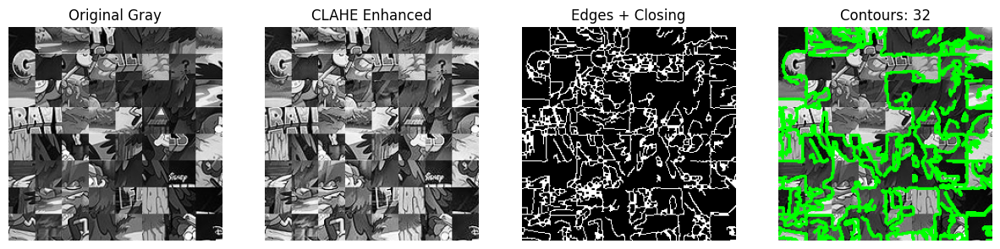

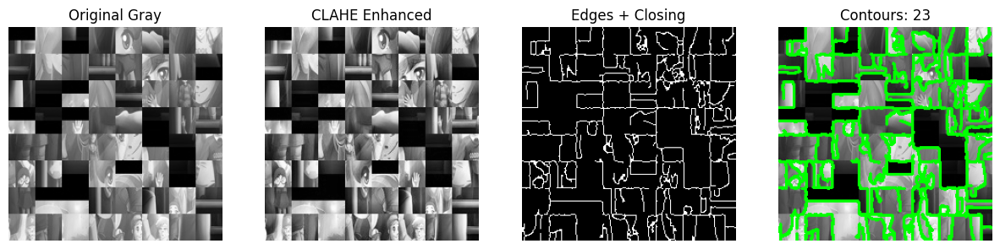

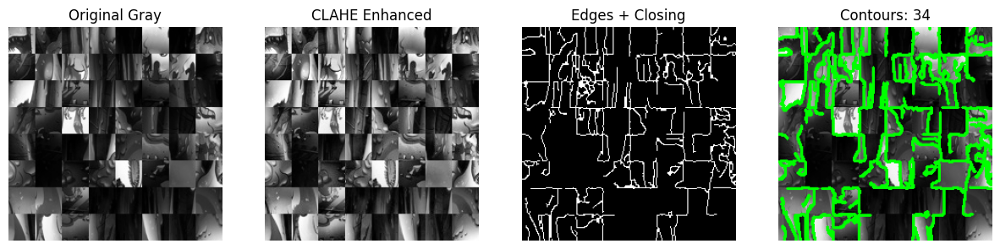

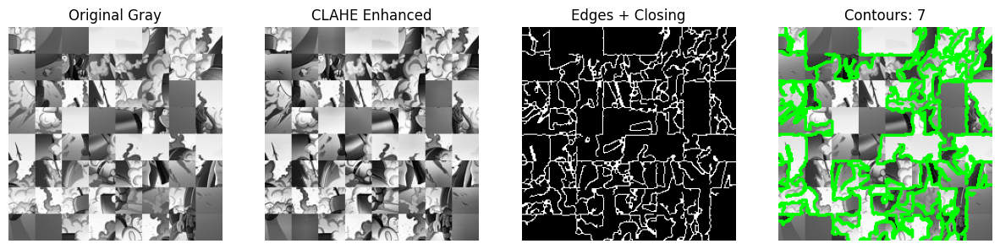

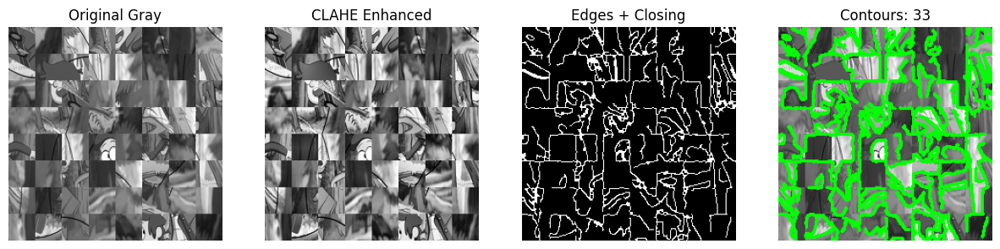

[array([[  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        ...,
        [255, 255, 255, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ..., 255, 255, 255]], dtype=uint8),
 array([[  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        ...,
        [  0,   0, 255, ...,   0,   0,   0],
        [  0,   0, 255, ...,   0,   0,   0],
        [  0,   0, 255, ...,   0,   0,   0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],


In [ ]:
clahe_bilateral_canny_pipeline(grayscale_images)

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# --- Function to apply CLAHE ---
def apply_clahe(images, clipLimit=2.0, tileGridSize=(8,8)):
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
    enhanced_images = []
    for img in images:
        enhanced = clahe.apply(img)
        enhanced_images.append(enhanced)
    return enhanced_images

# --- Function to apply Bilateral Filter ---
def apply_bilateral(images, d=9, sigmaColor=100, sigmaSpace=100):
    filtered_images = []
    for img in images:
        b = cv2.bilateralFilter(img, d, sigmaColor, sigmaSpace)
        filtered_images.append(b)
    return filtered_images

# --- Function to apply Canny ---
def apply_canny(images, threshold1=70, threshold2=200):
    edges_list = []
    for img in images:
        edges = cv2.Canny(img, threshold1, threshold2)
        edges_list.append(edges)
    return edges_list

# --- Contour filtering function ---
def filter_contours(contours, min_area=500, min_compactness=1.5, max_compactness=10):
    filtered = []
    for c in contours:
        area = cv2.contourArea(c)
        if area < min_area:
            continue
        perimeter = cv2.arcLength(c, True)
        if perimeter == 0:
            continue
        compactness = (perimeter**2) / (4*np.pi*area)
        if compactness < min_compactness or compactness > max_compactness:
            continue
        filtered.append(c)
    return filtered

# --- Pipeline: CLAHE + Bilateral + Canny + Closing + Filtering ---
def clahe_bilateral_canny_pipeline(gray_images):
    # Step 1: CLAHE enhancement
    clahe_images = apply_clahe(gray_images, clipLimit=2.0, tileGridSize=(8,8))

    # Step 2: Bilateral filtering
    bilateral_images = apply_bilateral(clahe_images, d=9, sigmaColor=100, sigmaSpace=100)

    # Step 3: Canny edge detection
    edges_images = apply_canny(bilateral_images, threshold1=70, threshold2=200)

    # Step 4: Morphological closing to connect edges
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))
    closed_images = []
    for edges in edges_images:
        closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
        closed_images.append(closed)

    # Step 5: Contour extraction + filtering + visualization
    for i in range(5):  # show first 5 results
        contours, _ = cv2.findContours(closed_images[i], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        filtered = filter_contours(contours)

        contour_vis = cv2.cvtColor(gray_images[i], cv2.COLOR_GRAY2BGR)
        cv2.drawContours(contour_vis, filtered, -1, (0,255,0), 2)

        plt.figure(figsize=(15,5))
        plt.subplot(1,4,1); plt.imshow(gray_images[i], cmap='gray'); plt.title("Original Gray"); plt.axis('off')
        plt.subplot(1,4,2); plt.imshow(clahe_images[i], cmap='gray'); plt.title("CLAHE Enhanced"); plt.axis('off')
        plt.subplot(1,4,3); plt.imshow(closed_images[i], cmap='gray'); plt.title("Edges + Closing"); plt.axis('off')
        plt.subplot(1,4,4); plt.imshow(contour_vis); plt.title(f"Filtered Contours: {len(filtered)}"); plt.axis('off')
        plt.show()

    return closed_images


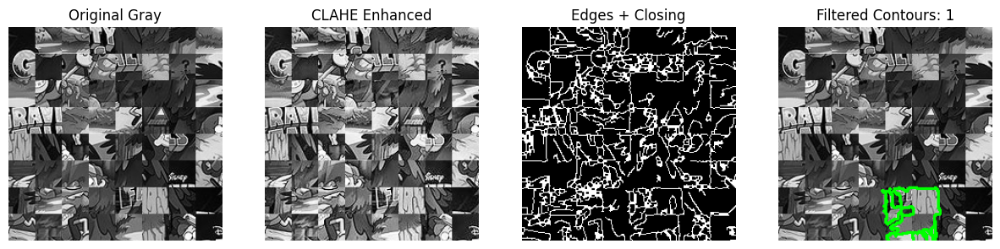

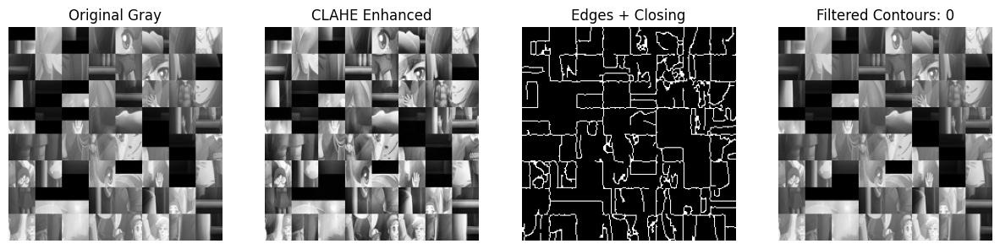

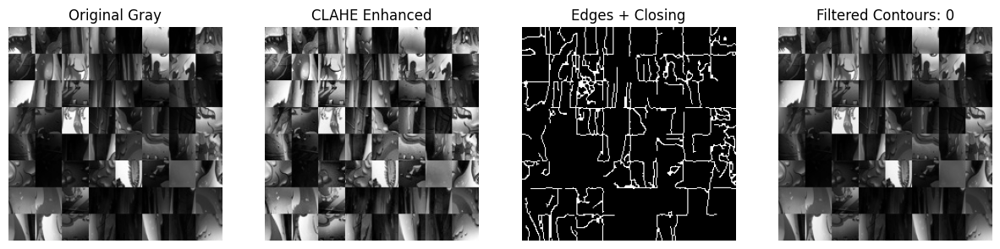

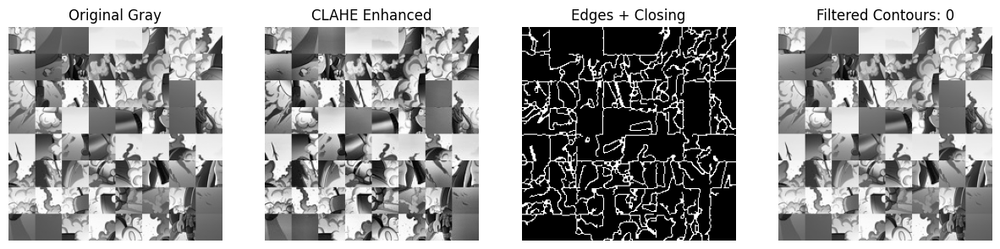

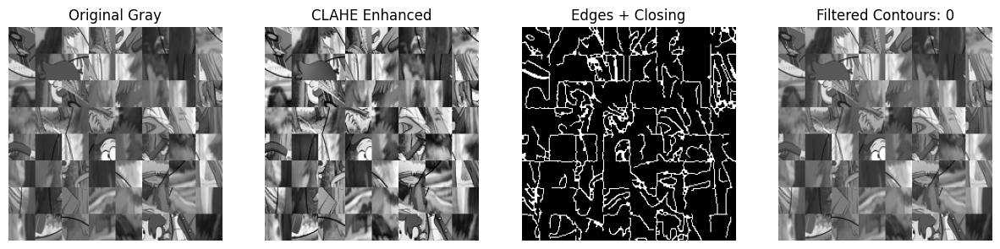

[array([[  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        ...,
        [255, 255, 255, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ..., 255, 255, 255]], dtype=uint8),
 array([[  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        [  0,   0,   0, ...,   0,   0,   0],
        ...,
        [  0,   0, 255, ...,   0,   0,   0],
        [  0,   0, 255, ...,   0,   0,   0],
        [  0,   0, 255, ...,   0,   0,   0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],


In [ ]:
clahe_bilateral_canny_pipeline(grayscale_images)


TRYING: MORPHOLOGICAL GRADIENT APPROACH

✓ Processed 110 images



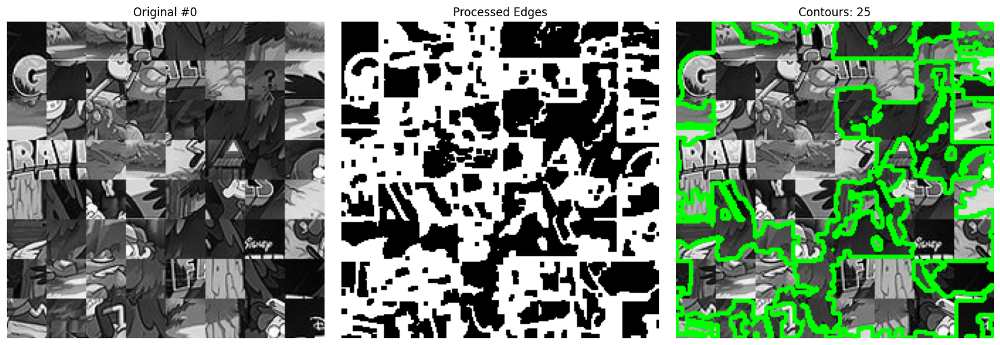

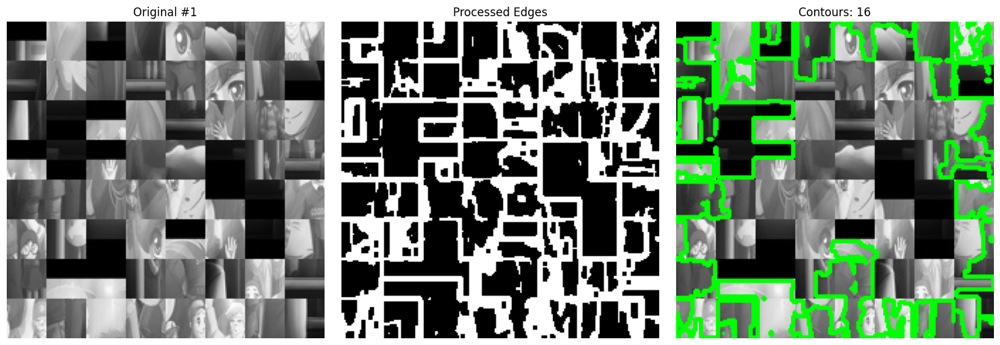

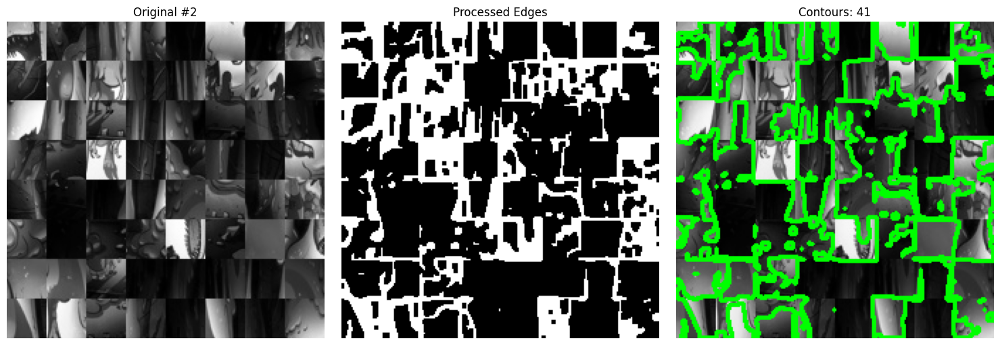

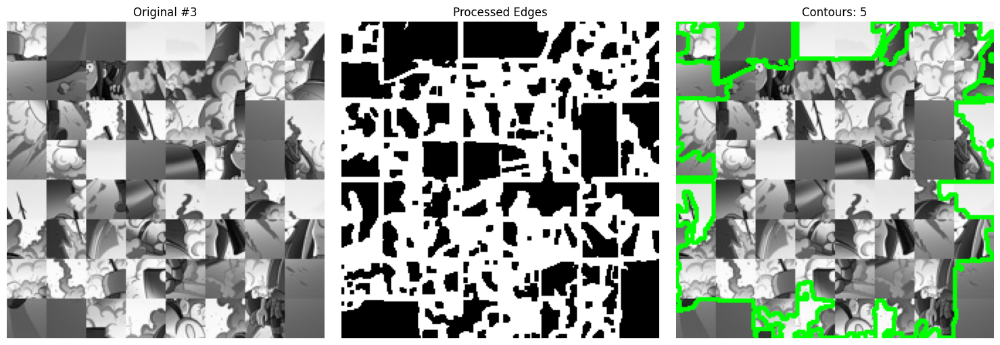

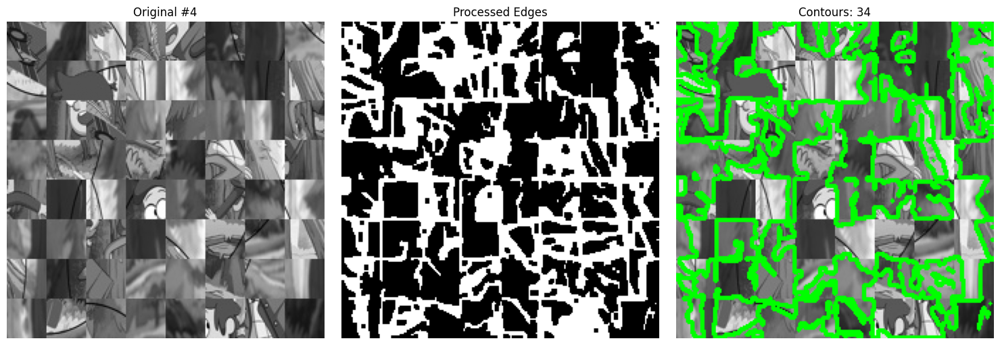

In [7]:
# ==========================================
# IMPROVED: MORPHOLOGICAL GRADIENT APPROACH
# ==========================================

print("\n" + "="*60)
print("TRYING: MORPHOLOGICAL GRADIENT APPROACH")
print("="*60 + "\n")

improved_edges = []

for gray in grayscale_images:
    # Step 1: Light Gaussian blur
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Step 2: Morphological Gradient (this is the key!)
    kernel = np.ones((3, 3), np.uint8)
    gradient = cv2.morphologyEx(blurred, cv2.MORPH_GRADIENT, kernel)

    # Step 3: Threshold (lower threshold to keep more edges)
    _, binary = cv2.threshold(gradient, 25, 255, cv2.THRESH_BINARY)

    # Step 4: Light closing to connect nearby edges
    closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)

    improved_edges.append(closed)

print(f"✓ Processed {len(improved_edges)} images\n")


# --- Visualize Results ---
for i in range(5):
    original = grayscale_images[i]
    edges = improved_edges[i]

    # Count contours
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(original, cmap='gray')
    plt.title(f"Original #{i}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(edges, cmap='gray')
    plt.title(f"Processed Edges")
    plt.axis('off')

    # Draw contours
    contour_img = cv2.cvtColor(original, cv2.COLOR_GRAY2BGR)
    cv2.drawContours(contour_img, contours, -1, (0, 255, 0), 2)

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(contour_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Contours: {len(contours)}")
    plt.axis('off')

    plt.tight_layout()
    plt.show()


MILESTONE 1: PROPER TILE EXTRACTION PIPELINE

  Image 0: Extracted 64 tiles
  Image 1: Extracted 64 tiles
  Image 2: Extracted 64 tiles
  Image 3: Extracted 64 tiles
  Image 4: Extracted 64 tiles
  Image 5: Extracted 64 tiles
  Image 6: Extracted 64 tiles
  Image 7: Extracted 64 tiles
  Image 8: Extracted 64 tiles
  Image 9: Extracted 64 tiles
  Image 10: Extracted 64 tiles
  Image 11: Extracted 64 tiles
  Image 12: Extracted 64 tiles
  Image 13: Extracted 64 tiles
  Image 14: Extracted 64 tiles
  Image 15: Extracted 64 tiles
  Image 16: Extracted 64 tiles
  Image 17: Extracted 64 tiles
  Image 18: Extracted 64 tiles
  Image 19: Extracted 64 tiles
  Image 20: Extracted 64 tiles
  Image 21: Extracted 64 tiles
  Image 22: Extracted 64 tiles
  Image 23: Extracted 64 tiles
  Image 24: Extracted 64 tiles
  Image 25: Extracted 64 tiles
  Image 26: Extracted 64 tiles
  Image 27: Extracted 64 tiles
  Image 28: Extracted 64 tiles
  Image 29: Extracted 64 tiles
  Image 30: Extracted 64 tiles
  

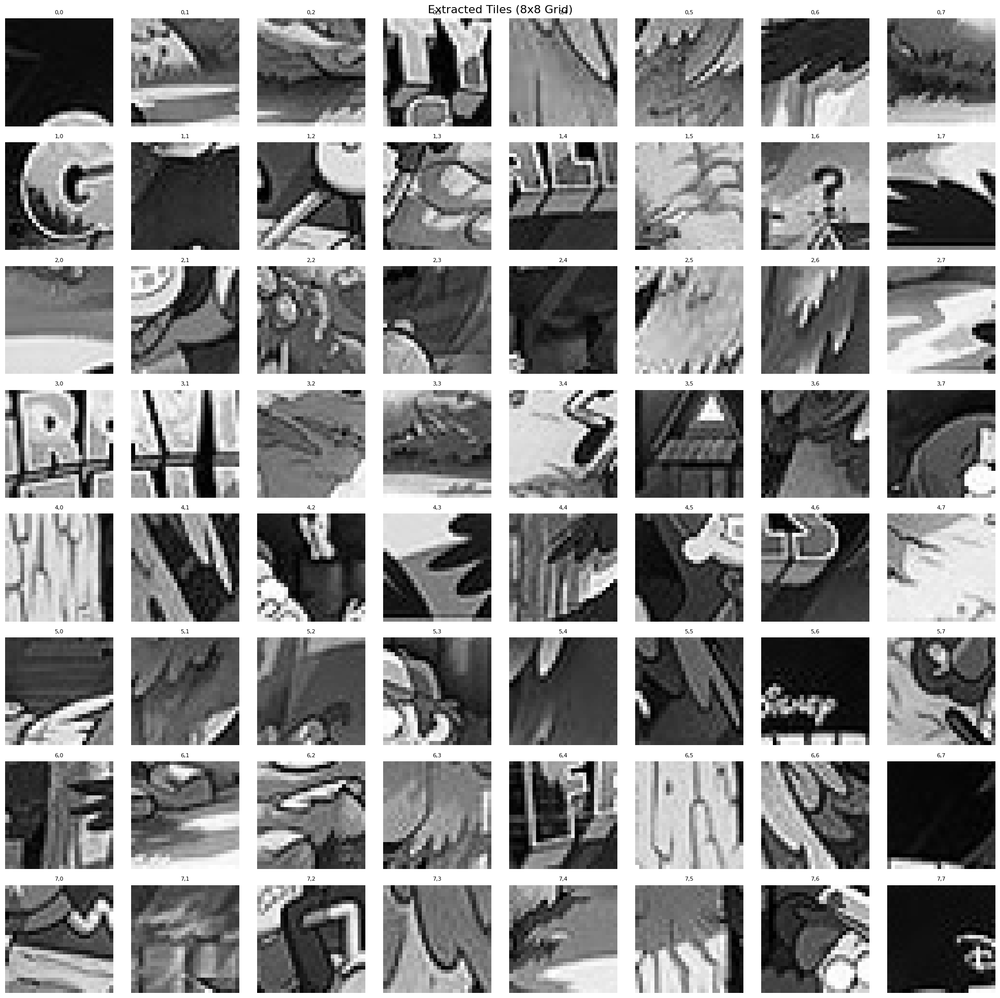

Showing enhancement pipeline for sample tiles...



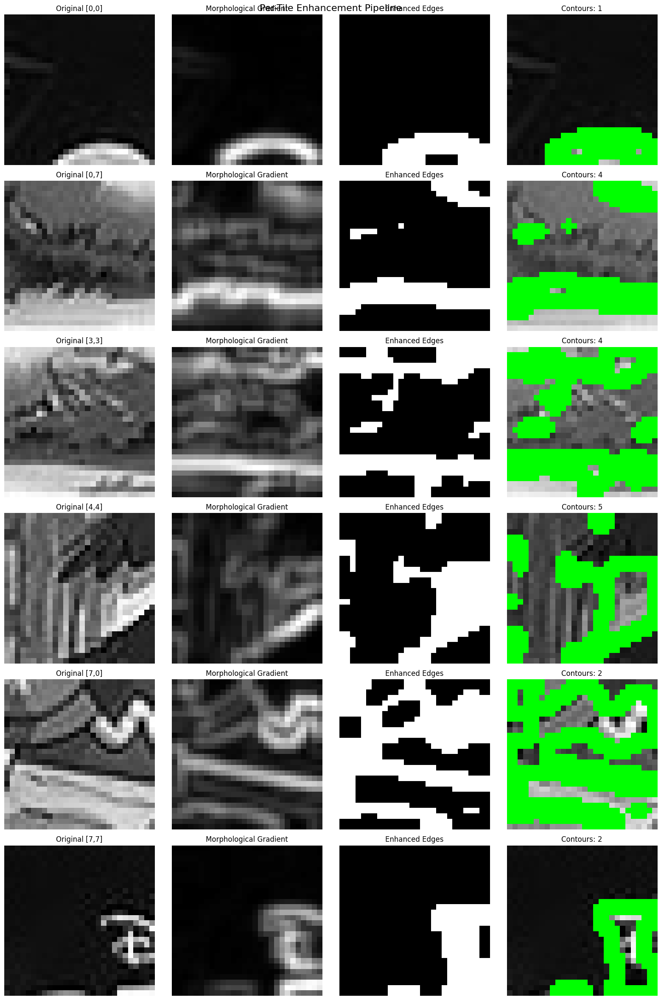

Visualizing all enhanced edges...



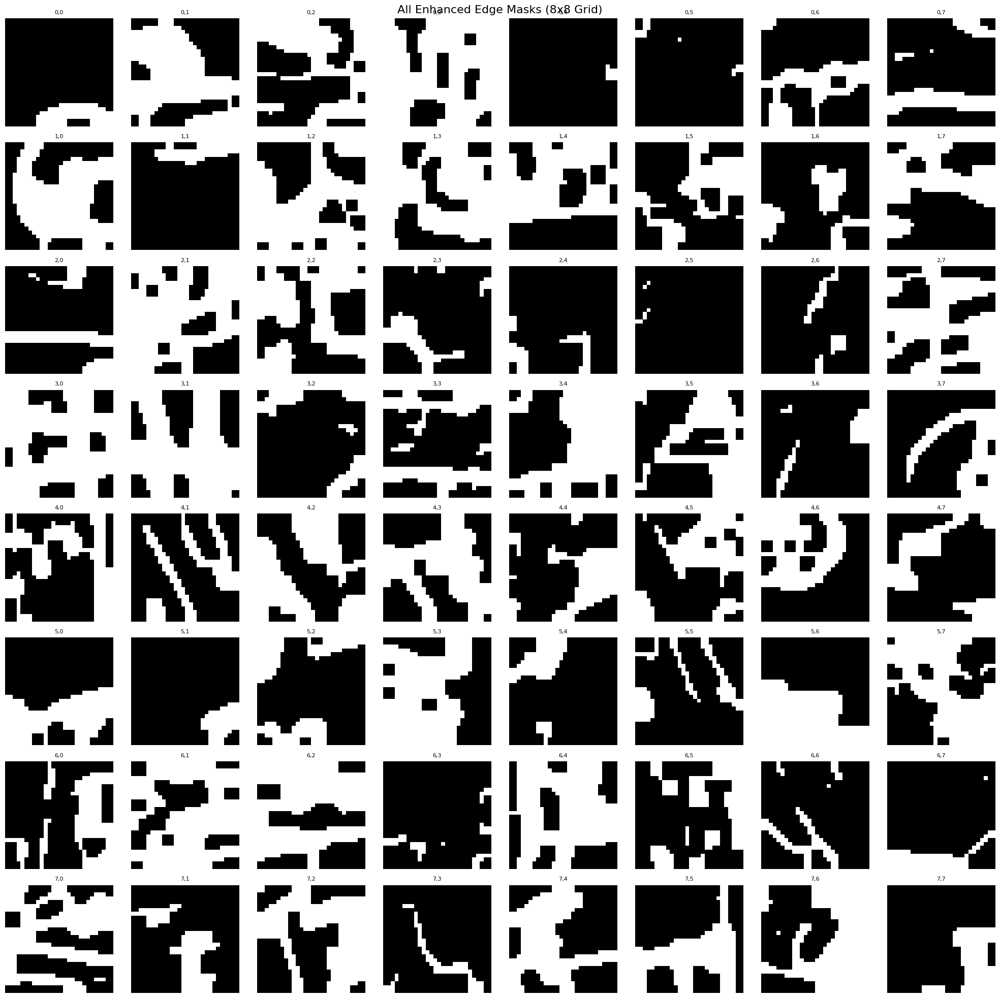

SAVING MILESTONE 1 OUTPUTS

✓ Saved 64 original tiles to 'milestone1_output/tiles/'
✓ Saved 64 enhanced edges to 'milestone1_output/enhanced_edges/'
✓ Saved 64 gradients to 'milestone1_output/gradient/'

MILESTONE 1 COMPLETE!


In [8]:
# ==========================================
# CORRECT APPROACH: UNIFORM GRID + PER-TILE ENHANCEMENT
# ==========================================

print("\n" + "="*60)
print("MILESTONE 1: PROPER TILE EXTRACTION PIPELINE")
print("="*60 + "\n")

# ==========================================
# STAGE 1: EXTRACT TILES (NO EDGE DETECTION YET)
# ==========================================

def extract_tiles_from_image(image, grid_size=(8, 8)):
    """
    Extract tiles using uniform grid division.
    Simple and reliable for assembled puzzles.
    """
    height, width = image.shape[:2]
    rows, cols = grid_size

    piece_height = height // rows
    piece_width = width // cols

    tiles = []

    for row in range(rows):
        for col in range(cols):
            y1 = row * piece_height
            y2 = (row + 1) * piece_height
            x1 = col * piece_width
            x2 = (col + 1) * piece_width

            tile = image[y1:y2, x1:x2].copy()

            tiles.append({
                'tile': tile,
                'position': (row, col),
                'index': row * cols + col
            })

    return tiles


# Extract tiles from all images
all_tiles = []

for img_idx, gray in enumerate(grayscale_images):
    tiles = extract_tiles_from_image(gray, grid_size=(8, 8))
    all_tiles.append(tiles)
    print(f"  Image {img_idx}: Extracted {len(tiles)} tiles")

print(f"\n✓ Total: {len(all_tiles)} images processed")
print(f"✓ Total tiles: {len(all_tiles) * 64}\n")


# ==========================================
# STAGE 2: ENHANCE EACH TILE INDIVIDUALLY
# ==========================================

def enhance_tile(tile):
    """
    Apply edge enhancement to a single tile.
    This is where morphological gradient works great!
    """
    # Gaussian blur
    blurred = cv2.GaussianBlur(tile, (5, 5), 0)

    # Morphological gradient
    kernel = np.ones((3, 3), np.uint8)
    gradient = cv2.morphologyEx(blurred, cv2.MORPH_GRADIENT, kernel)

    # Threshold
    _, binary = cv2.threshold(gradient, 30, 255, cv2.THRESH_BINARY)

    # Closing
    closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)

    # Find contours
    contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Visualization
    contour_vis = cv2.cvtColor(tile, cv2.COLOR_GRAY2BGR)
    if contours:
        cv2.drawContours(contour_vis, contours, -1, (0, 255, 0), 2)

    return {
        'original': tile,
        'gradient': gradient,
        'edges': closed,
        'contours': contours,
        'contour_vis': contour_vis
    }


# Enhance tiles from first image
print("="*60)
print("ENHANCING TILES FROM IMAGE #0")
print("="*60 + "\n")

enhanced_tiles = []

for tile_data in all_tiles[0]:  # Process first image's tiles
    enhanced = enhance_tile(tile_data['tile'])
    enhanced_tiles.append({
        'position': tile_data['position'],
        'index': tile_data['index'],
        **enhanced
    })

print(f"✓ Enhanced {len(enhanced_tiles)} tiles\n")


# ==========================================
# VISUALIZE: Show Grid of Original Tiles
# ==========================================

print("Visualizing extracted tiles (8x8 grid)...\n")

fig, axes = plt.subplots(8, 8, figsize=(20, 20))

for tile_data in enhanced_tiles:
    row, col = tile_data['position']
    tile = tile_data['original']

    axes[row, col].imshow(tile, cmap='gray')
    axes[row, col].set_title(f'{row},{col}', fontsize=8)
    axes[row, col].axis('off')

plt.suptitle('Extracted Tiles (8x8 Grid)', fontsize=16)
plt.tight_layout()
plt.show()


# ==========================================
# VISUALIZE: Sample Enhanced Tiles
# ==========================================

print("Showing enhancement pipeline for sample tiles...\n")

sample_indices = [0, 7, 27, 36, 56, 63]  # Corners and center

fig, axes = plt.subplots(len(sample_indices), 4, figsize=(16, 4*len(sample_indices)))

for idx, tile_idx in enumerate(sample_indices):
    tile_data = enhanced_tiles[tile_idx]
    row, col = tile_data['position']

    # Original
    axes[idx, 0].imshow(tile_data['original'], cmap='gray')
    axes[idx, 0].set_title(f'Original [{row},{col}]')
    axes[idx, 0].axis('off')

    # Gradient
    axes[idx, 1].imshow(tile_data['gradient'], cmap='gray')
    axes[idx, 1].set_title('Morphological Gradient')
    axes[idx, 1].axis('off')

    # Edges
    axes[idx, 2].imshow(tile_data['edges'], cmap='gray')
    axes[idx, 2].set_title('Enhanced Edges')
    axes[idx, 2].axis('off')

    # Contours
    axes[idx, 3].imshow(cv2.cvtColor(tile_data['contour_vis'], cv2.COLOR_BGR2RGB))
    axes[idx, 3].set_title(f'Contours: {len(tile_data["contours"])}')
    axes[idx, 3].axis('off')

plt.suptitle('Per-Tile Enhancement Pipeline', fontsize=16)
plt.tight_layout()
plt.show()


# ==========================================
# VISUALIZE: All Enhanced Edges (8x8 Grid)
# ==========================================

print("Visualizing all enhanced edges...\n")

fig, axes = plt.subplots(8, 8, figsize=(20, 20))

for tile_data in enhanced_tiles:
    row, col = tile_data['position']
    edges = tile_data['edges']

    axes[row, col].imshow(edges, cmap='gray')
    axes[row, col].set_title(f'{row},{col}', fontsize=8)
    axes[row, col].axis('off')

plt.suptitle('All Enhanced Edge Masks (8x8 Grid)', fontsize=16)
plt.tight_layout()
plt.show()


# ==========================================
# SAVE OUTPUTS (Milestone 1 Deliverables)
# ==========================================

import os

output_dir = 'milestone1_output'
os.makedirs(f'{output_dir}/tiles', exist_ok=True)
os.makedirs(f'{output_dir}/enhanced_edges', exist_ok=True)
os.makedirs(f'{output_dir}/gradient', exist_ok=True)

print("="*60)
print("SAVING MILESTONE 1 OUTPUTS")
print("="*60 + "\n")

for tile_data in enhanced_tiles:
    row, col = tile_data['position']

    # Save original tile
    cv2.imwrite(f'{output_dir}/tiles/tile_{row}_{col}.png', tile_data['original'])

    # Save enhanced edges
    cv2.imwrite(f'{output_dir}/enhanced_edges/edge_{row}_{col}.png', tile_data['edges'])

    # Save gradient
    cv2.imwrite(f'{output_dir}/gradient/gradient_{row}_{col}.png', tile_data['gradient'])

print(f"✓ Saved 64 original tiles to '{output_dir}/tiles/'")
print(f"✓ Saved 64 enhanced edges to '{output_dir}/enhanced_edges/'")
print(f"✓ Saved 64 gradients to '{output_dir}/gradient/'")
print(f"\n{'='*60}")
print("MILESTONE 1 COMPLETE!")
print("="*60)